# ECE 228 Unet (CVLab EPFL dataset)

# Python imports

In [1]:
import numpy as np
import os
import sys
from matplotlib import pyplot as plt
%matplotlib inline  

import torch
from torch import nn
from torch.autograd import Variable
from torchvision import transforms, utils
from skimage import io, transform
from skimage.color import rgb2gray

from models import * 
from train import *
from data_loader import * 

from scipy import ndimage

from matplotlib.colors import ListedColormap

# Data Augmentation 


# Load data

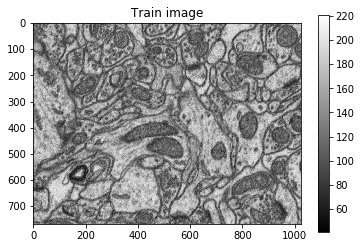

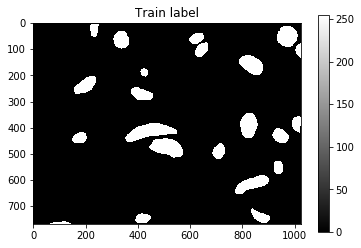

train_imgs shape =  (165, 1, 768, 1024)
train_labels shape =  (165, 1, 768, 1024)


In [2]:
from PIL import Image

data_tif = Image.open('datasets/epfl/training_epfl.tif')
train_imgs = []
i = 0
resize_size = 512

while True:
    try:
        data_tif.seek(i)
        train_imgs.append(np.array(data_tif))
        #train_imgs.append(transform.resize(np.array(data_tif),(resize_size,resize_size)))

        i += 1
    except EOFError:
        # Not enough frames in img
        break
        
train_imgs = np.array(train_imgs)
train_imgs = np.expand_dims(train_imgs, axis=1)


label_tif = Image.open('datasets/epfl/training_epfl_lbl.tif')
train_labels = []
i = 0
while True:
    try:
        label_tif.seek(i)
        train_labels.append(np.array(label_tif))
        #train_labels.append(transform.resize(np.array(label_tif),(resize_size,resize_size)))

        i += 1
    except EOFError:
        # Not enough frames in img
        break
        
train_labels = np.array(train_labels)
train_labels = np.expand_dims(train_labels, axis=1)

plt.imshow(np.squeeze(train_imgs[0]),cmap="gray")
plt.title("Train image")
plt.colorbar()
plt.show()

plt.imshow(np.squeeze(train_labels[0]), cmap="gray")
plt.title("Train label")
plt.colorbar()
plt.show()


#train_imgs = (train_imgs/127)-1
train_labels = (train_labels != 0).astype(np.uint8)


print("train_imgs shape = ",train_imgs.shape)
print("train_labels shape = ",train_labels.shape)




# Run Training

GPU is enabled 
80/20 training/validation split
total number of images =  165
training set size =  17
val_size =  148
y train shape =  (17, 768, 1024)
y train shape =  (148, 768, 1024)
training image from batch 0


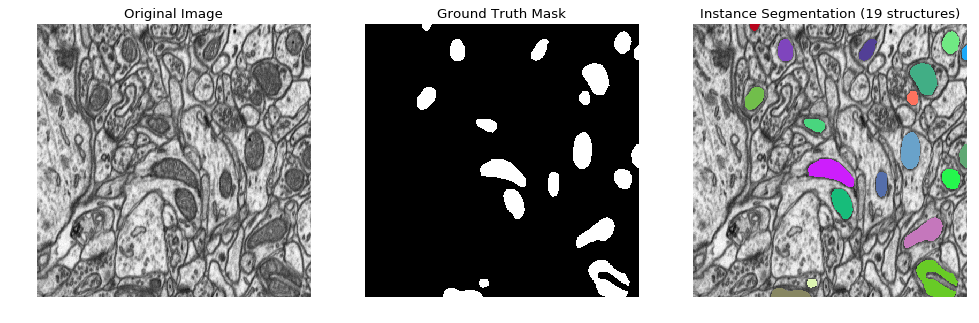

training image from batch 1


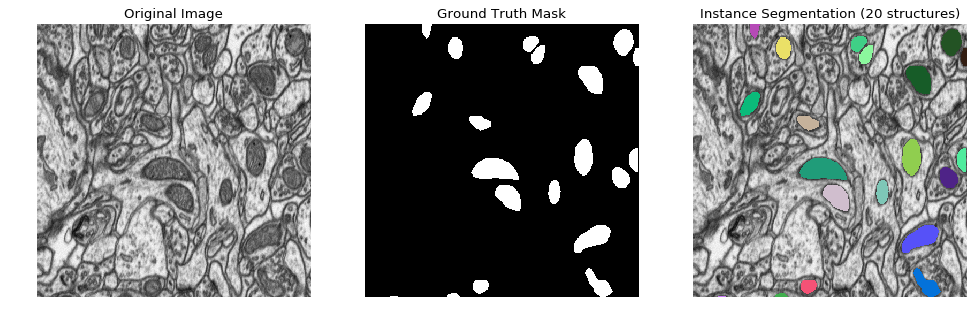

training image from batch 2


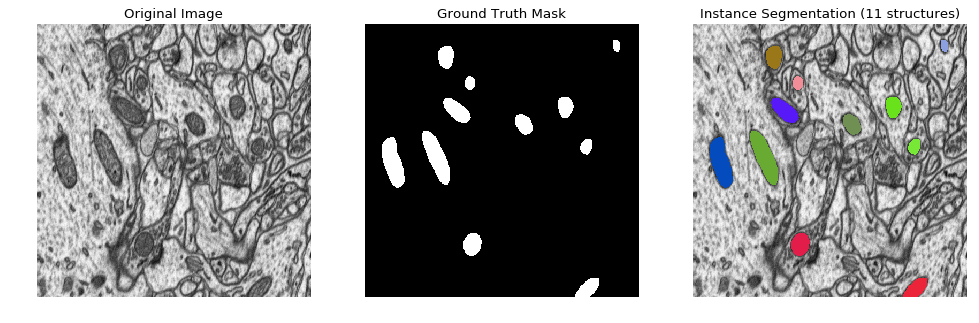

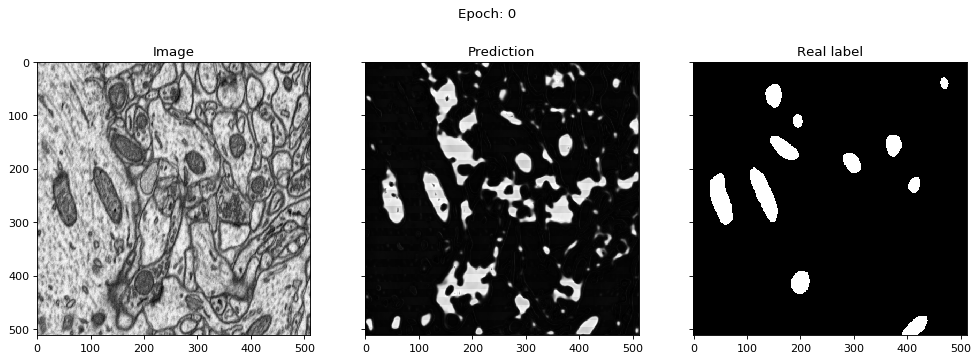

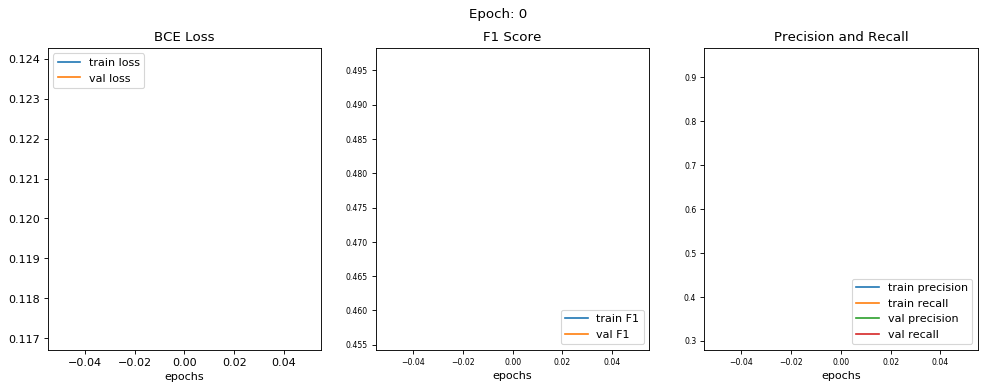

epoch [0/200] 
train loss = 0.1171, train f1 score = 0.4563 
train precision = 0.3106, train recall = 0.9363 

val loss = 0.1239, val f1 score = 0.4963 
val precision = 0.3474, val recall = 0.9341 




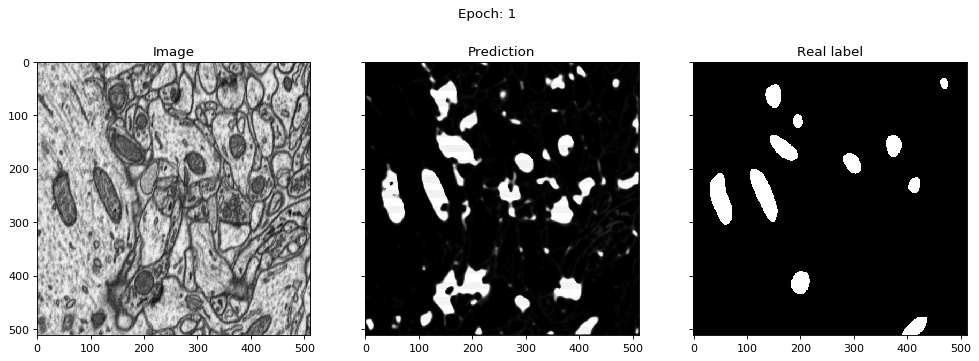

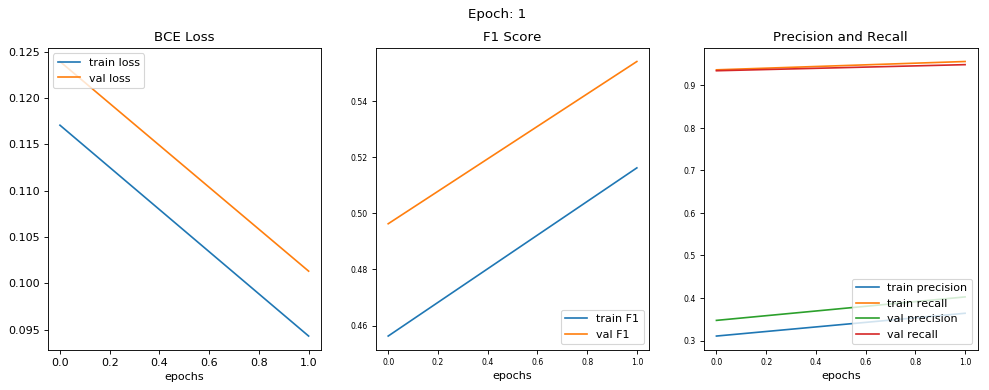

epoch [1/200] 
train loss = 0.0943, train f1 score = 0.5162 
train precision = 0.3642, train recall = 0.9558 

val loss = 0.1013, val f1 score = 0.5541 
val precision = 0.4026, val recall = 0.9484 




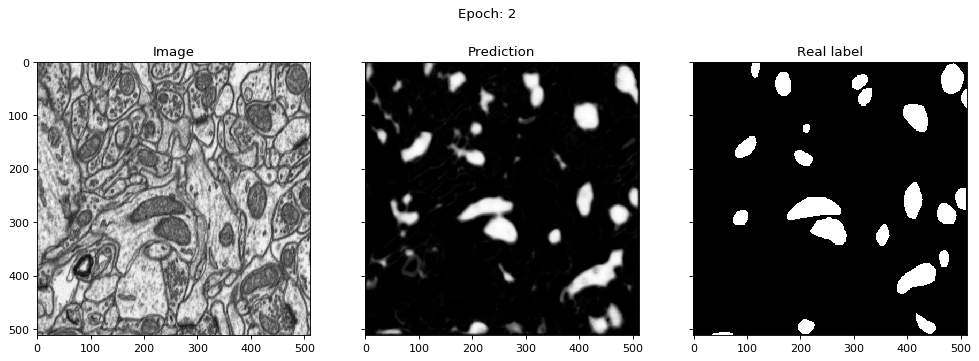

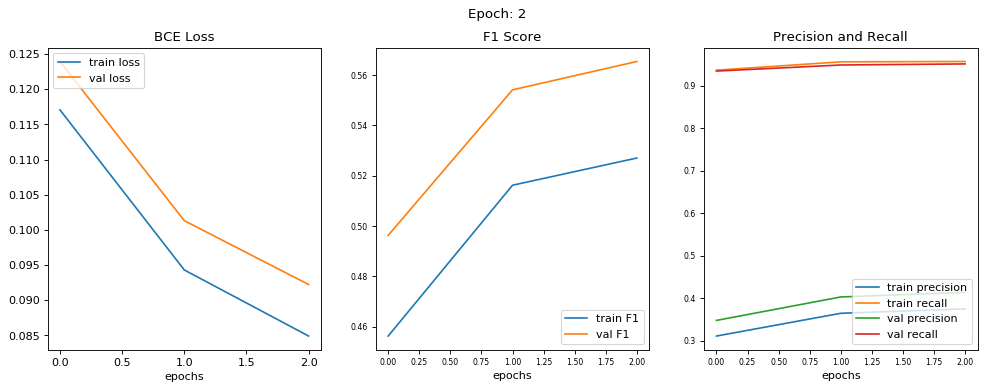

epoch [2/200] 
train loss = 0.0849, train f1 score = 0.5270 
train precision = 0.3746, train recall = 0.9566 

val loss = 0.0922, val f1 score = 0.5654 
val precision = 0.4136, val recall = 0.9509 




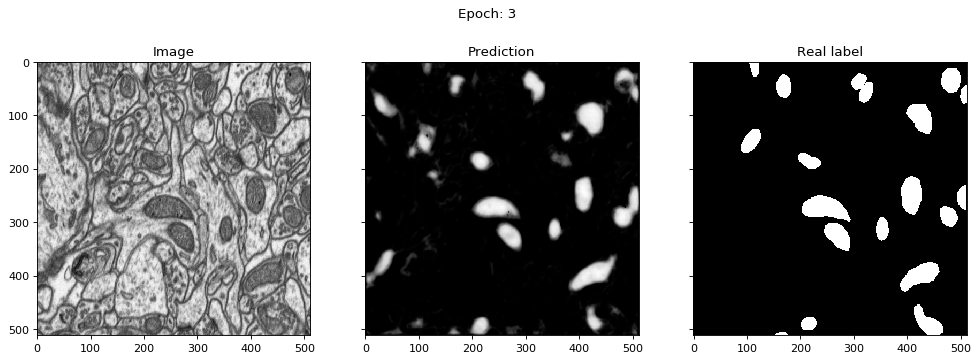

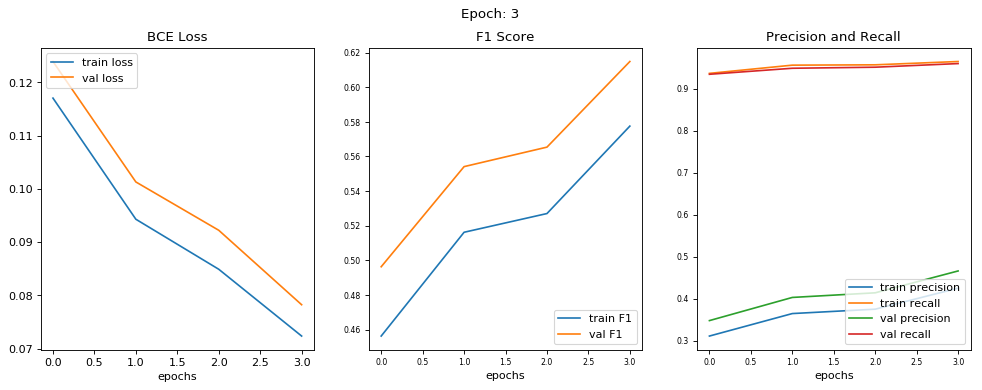

epoch [3/200] 
train loss = 0.0724, train f1 score = 0.5776 
train precision = 0.4246, train recall = 0.9645 

val loss = 0.0782, val f1 score = 0.6149 
val precision = 0.4657, val recall = 0.9596 




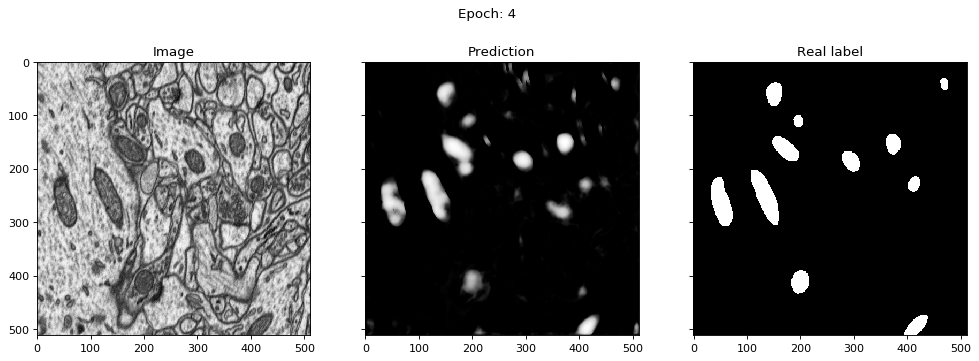

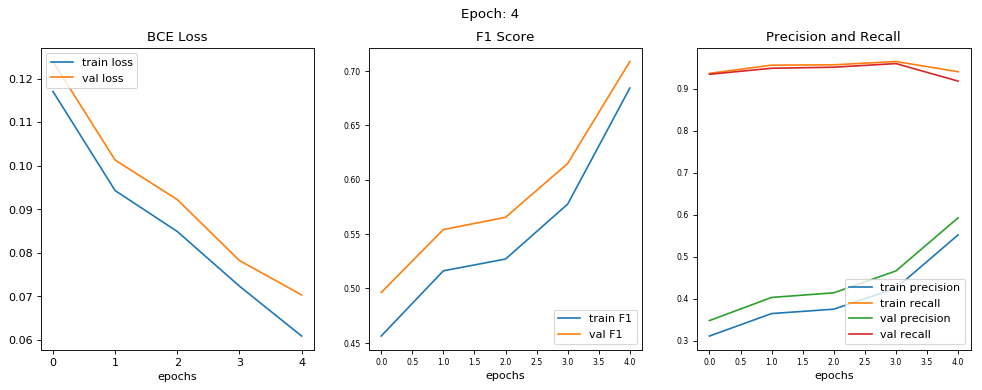

epoch [4/200] 
train loss = 0.0609, train f1 score = 0.6842 
train precision = 0.5516, train recall = 0.9402 

val loss = 0.0703, val f1 score = 0.7086 
val precision = 0.5923, val recall = 0.9178 




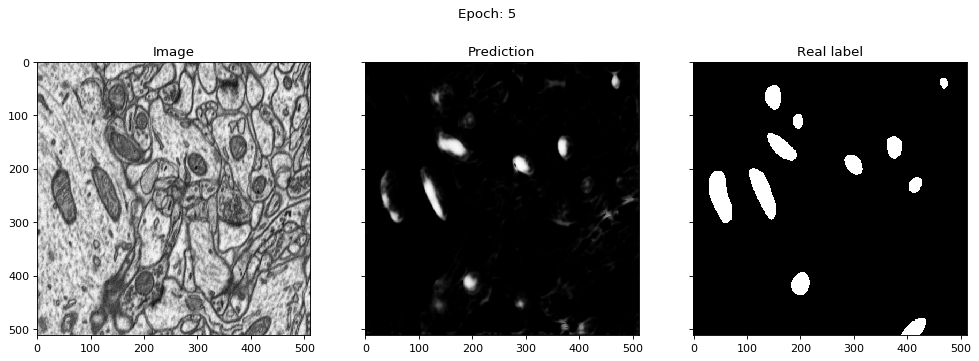

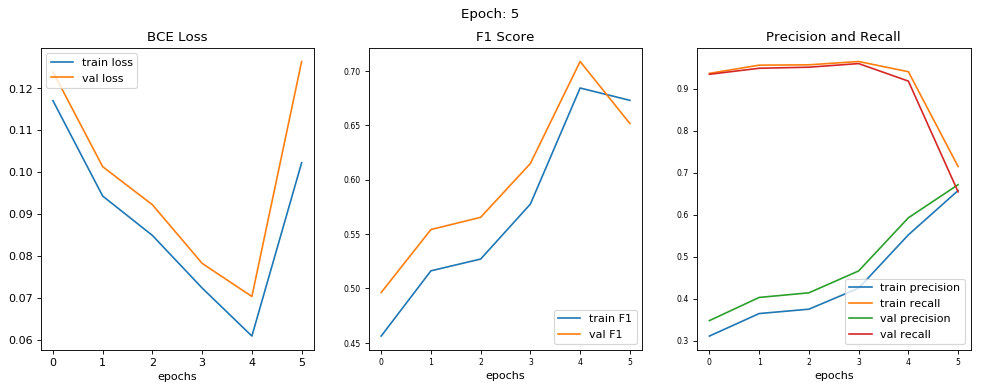

epoch [5/200] 
train loss = 0.1022, train f1 score = 0.6729 
train precision = 0.6572, train recall = 0.7144 

val loss = 0.1264, val f1 score = 0.6516 
val precision = 0.6711, val recall = 0.6541 




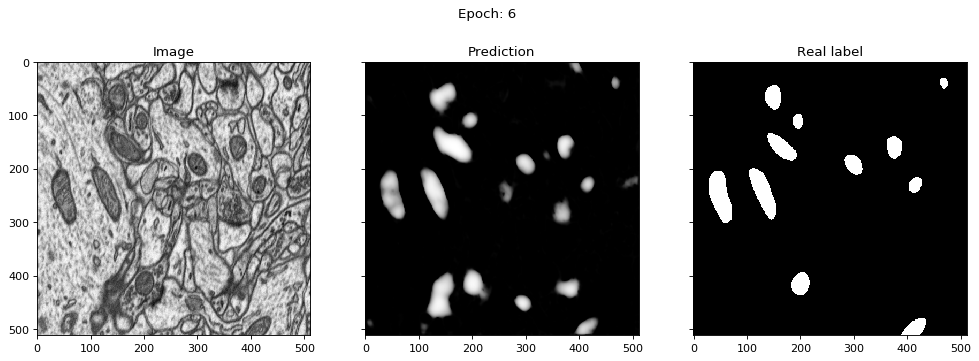

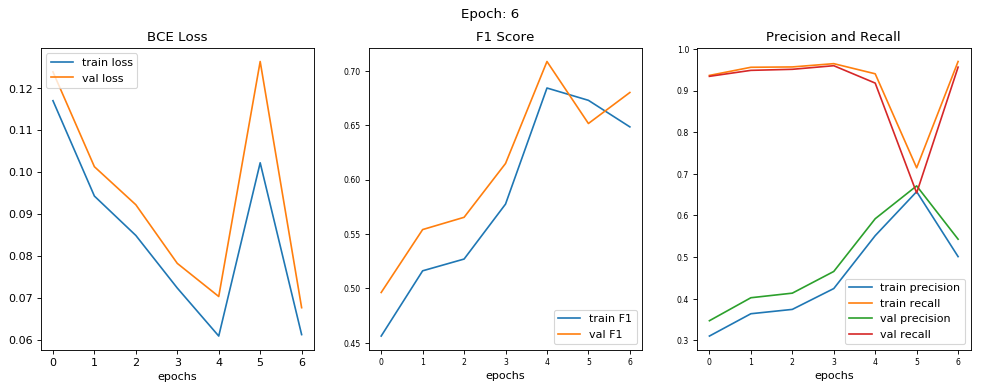

epoch [6/200] 
train loss = 0.0613, train f1 score = 0.6485 
train precision = 0.5013, train recall = 0.9697 

val loss = 0.0677, val f1 score = 0.6801 
val precision = 0.5431, val recall = 0.9562 




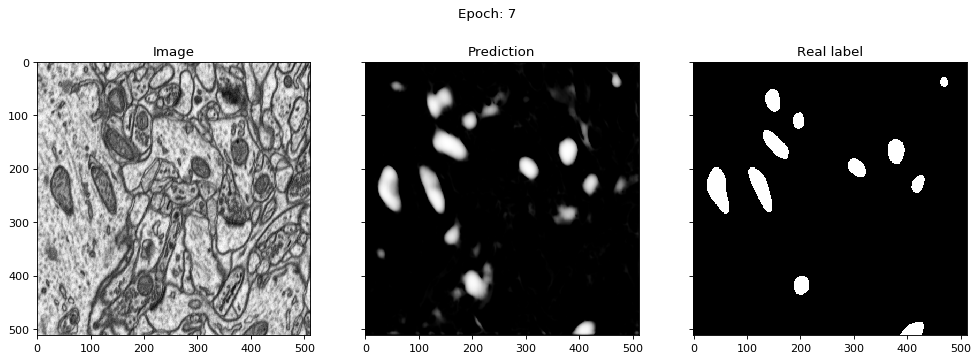

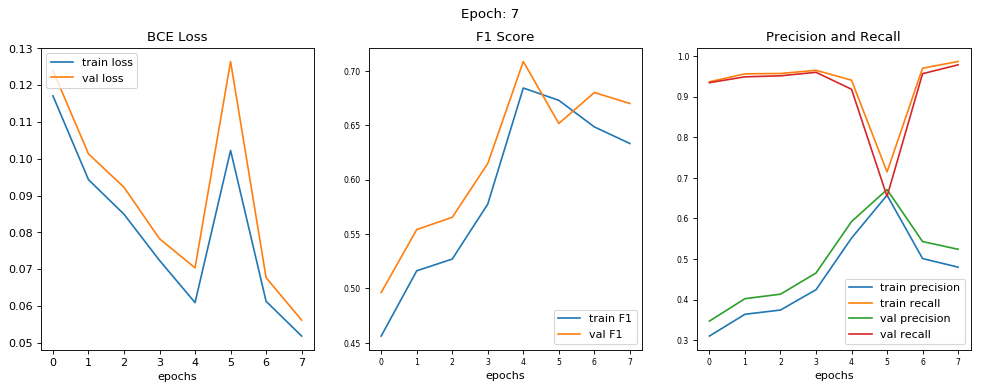

epoch [7/200] 
train loss = 0.0518, train f1 score = 0.6332 
train precision = 0.4802, train recall = 0.9861 

val loss = 0.0561, val f1 score = 0.6700 
val precision = 0.5241, val recall = 0.9780 




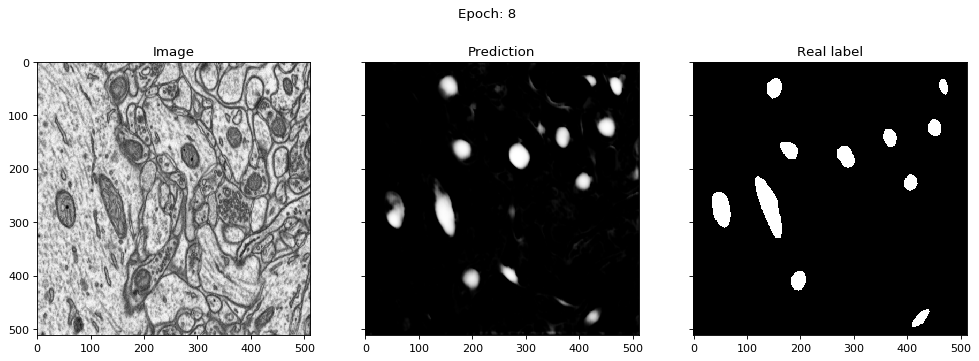

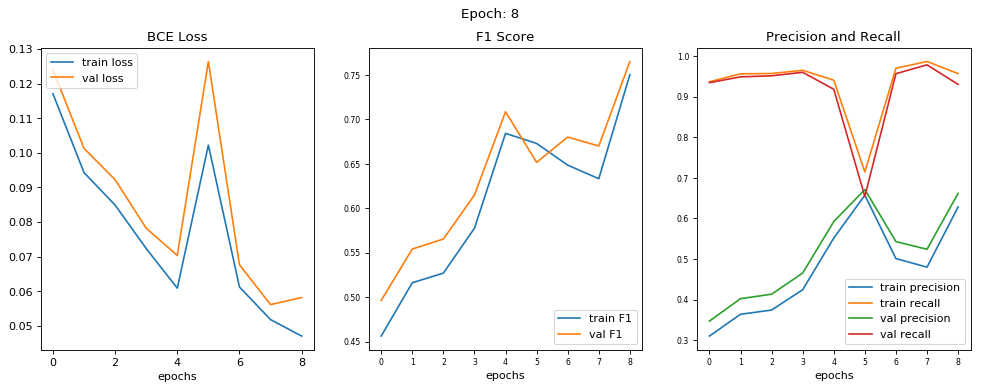

epoch [8/200] 
train loss = 0.0471, train f1 score = 0.7502 
train precision = 0.6282, train recall = 0.9564 

val loss = 0.0582, val f1 score = 0.7651 
val precision = 0.6617, val recall = 0.9298 




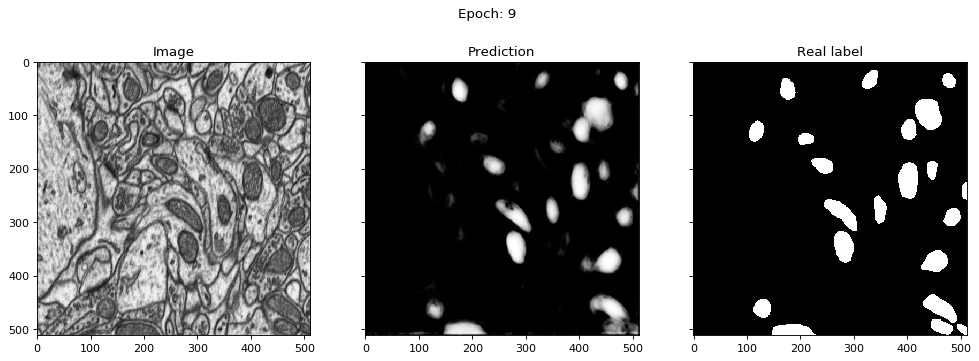

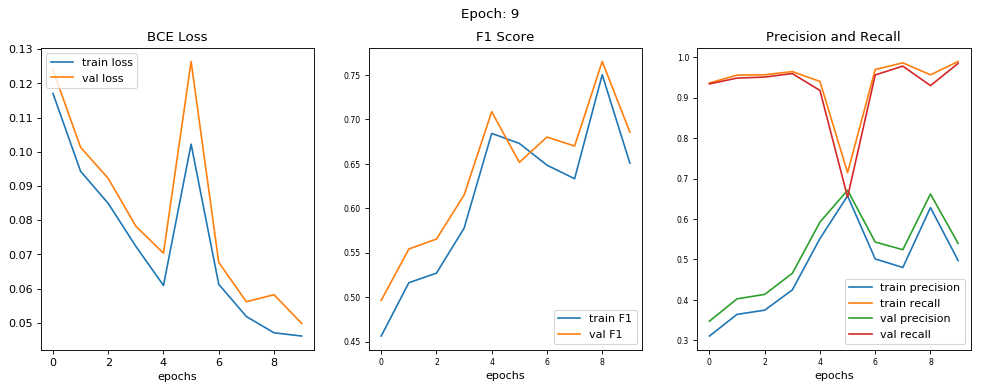

epoch [9/200] 
train loss = 0.0461, train f1 score = 0.6508 
train precision = 0.4975, train recall = 0.9894 

val loss = 0.0498, val f1 score = 0.6857 
val precision = 0.5398, val recall = 0.9846 




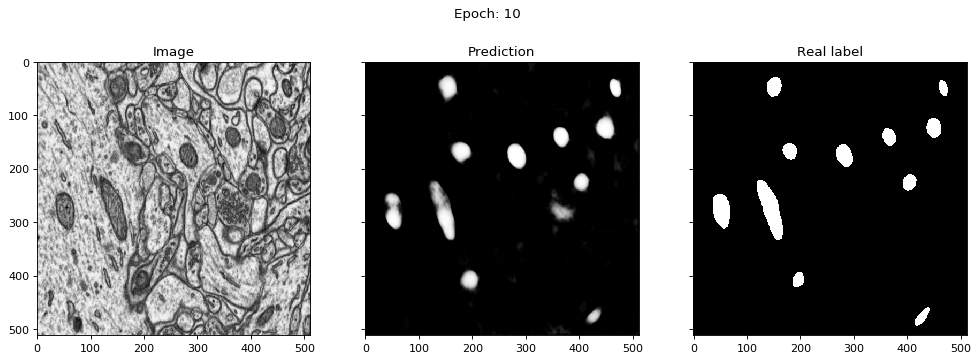

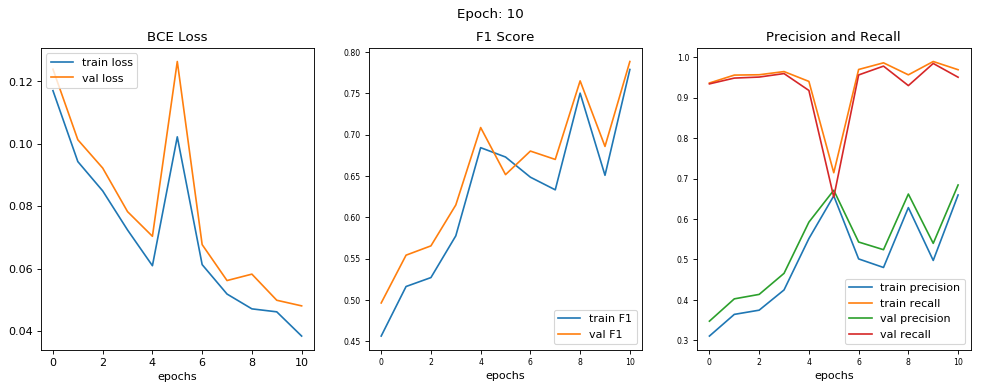

epoch [10/200] 
train loss = 0.0383, train f1 score = 0.7788 
train precision = 0.6594, train recall = 0.9691 

val loss = 0.0480, val f1 score = 0.7885 
val precision = 0.6841, val recall = 0.9505 




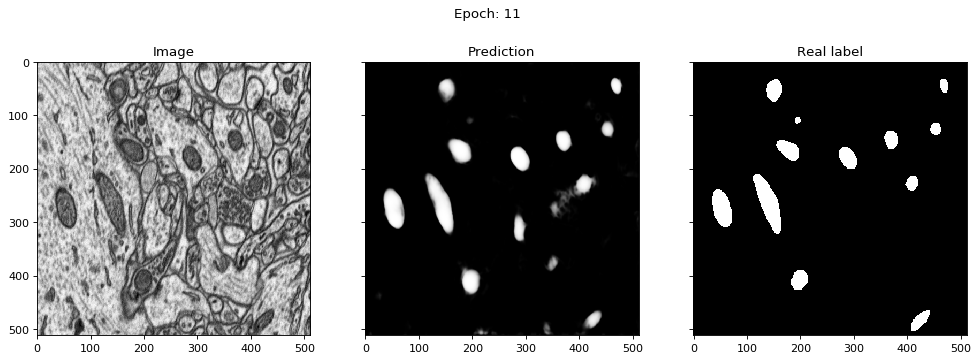

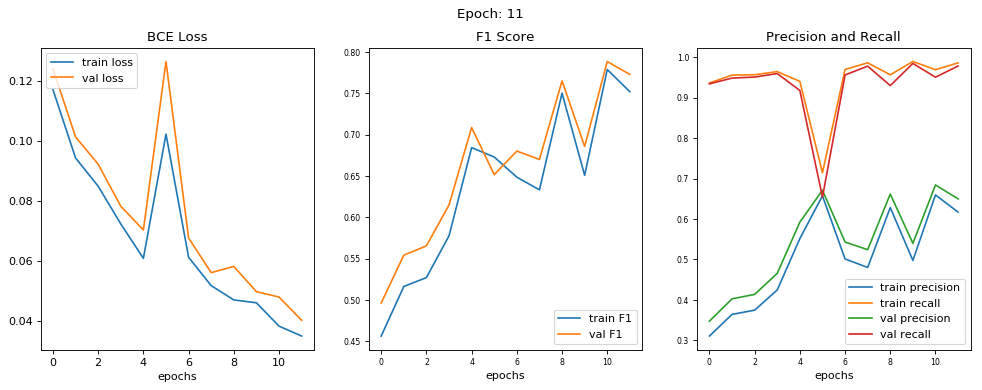

epoch [11/200] 
train loss = 0.0350, train f1 score = 0.7519 
train precision = 0.6171, train recall = 0.9860 

val loss = 0.0403, val f1 score = 0.7728 
val precision = 0.6497, val recall = 0.9783 




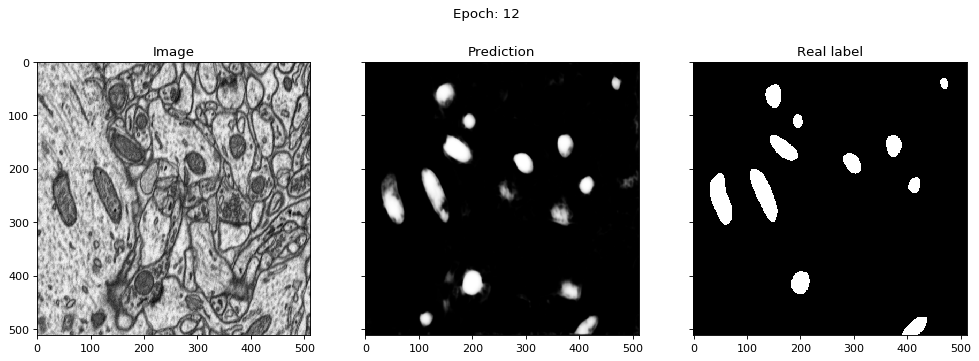

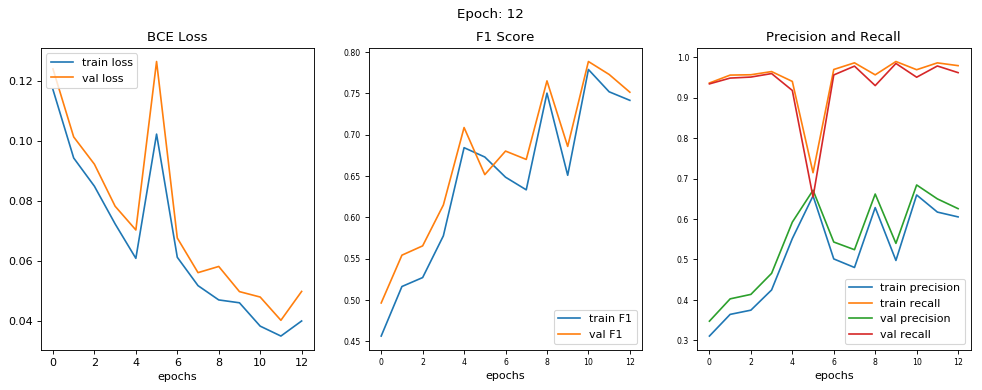

epoch [12/200] 
train loss = 0.0401, train f1 score = 0.7415 
train precision = 0.6052, train recall = 0.9791 

val loss = 0.0499, val f1 score = 0.7514 
val precision = 0.6256, val recall = 0.9619 




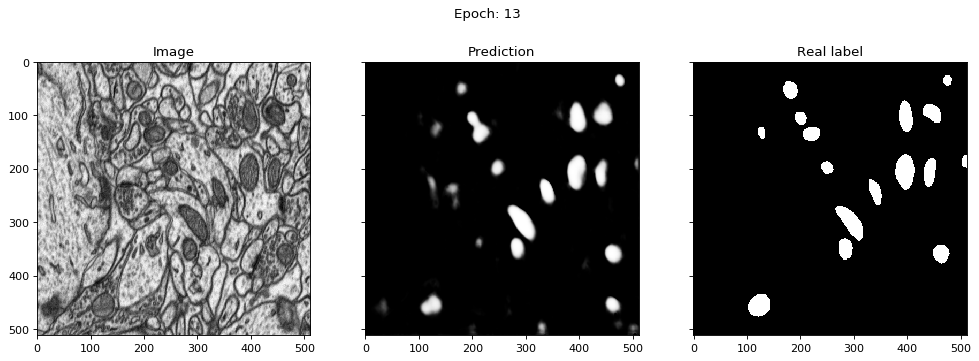

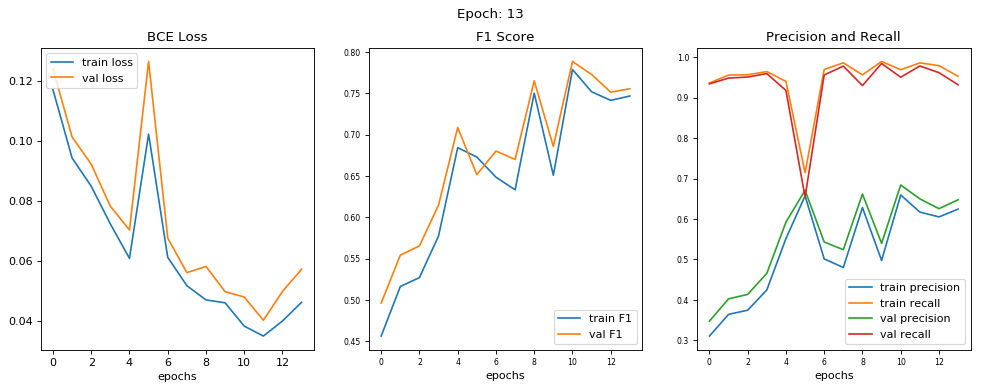

epoch [13/200] 
train loss = 0.0463, train f1 score = 0.7467 
train precision = 0.6244, train recall = 0.9530 

val loss = 0.0573, val f1 score = 0.7556 
val precision = 0.6476, val recall = 0.9318 




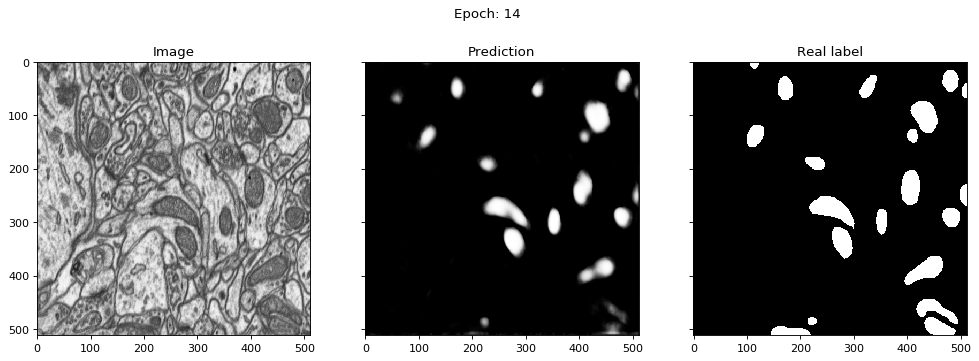

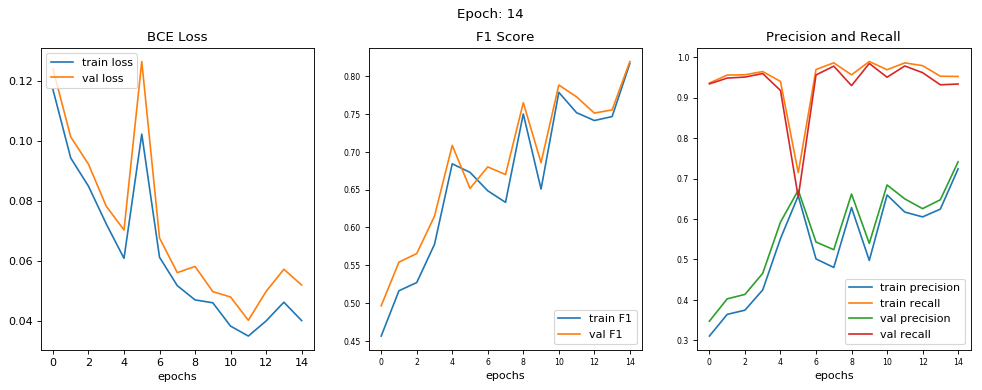

epoch [14/200] 
train loss = 0.0402, train f1 score = 0.8170 
train precision = 0.7239, train recall = 0.9524 

val loss = 0.0520, val f1 score = 0.8196 
val precision = 0.7413, val recall = 0.9337 




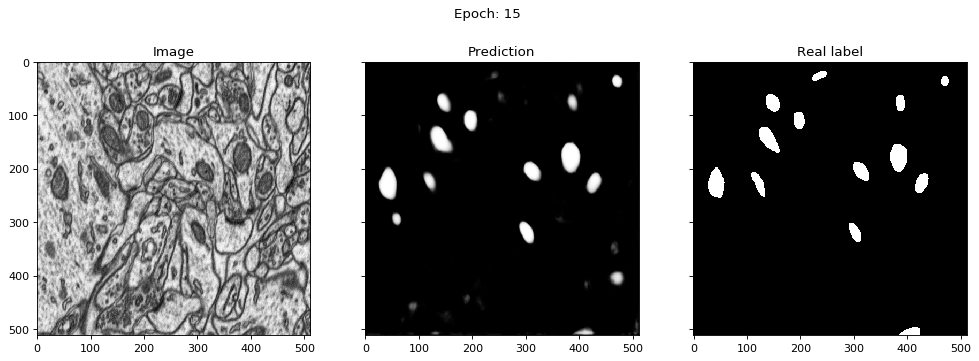

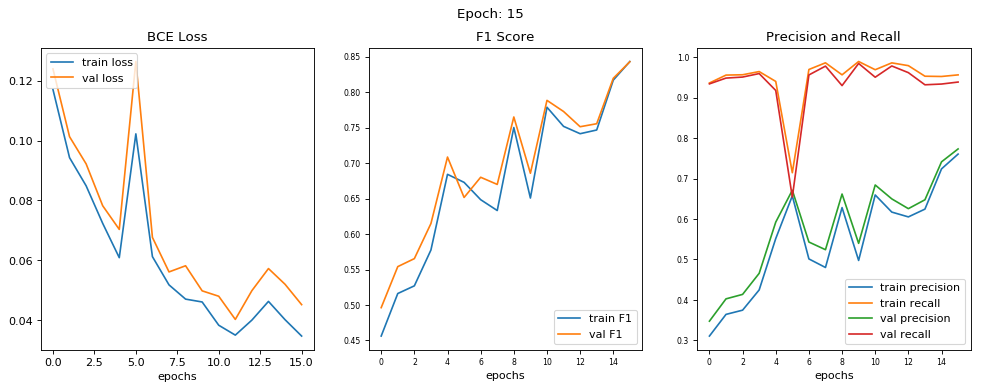

epoch [15/200] 
train loss = 0.0347, train f1 score = 0.8433 
train precision = 0.7605, train recall = 0.9563 

val loss = 0.0452, val f1 score = 0.8429 
val precision = 0.7732, val recall = 0.9386 




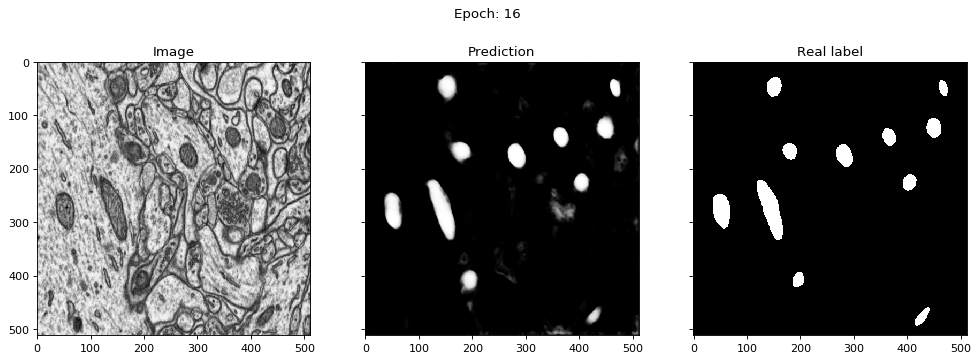

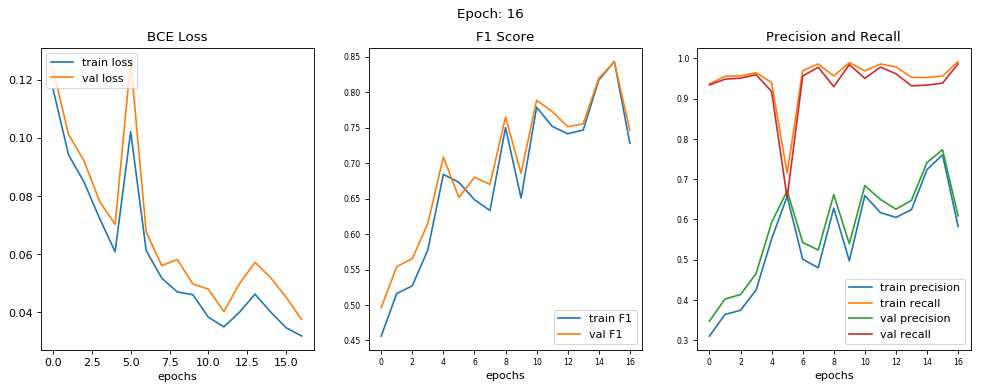

epoch [16/200] 
train loss = 0.0319, train f1 score = 0.7280 
train precision = 0.5828, train recall = 0.9923 

val loss = 0.0376, val f1 score = 0.7464 
val precision = 0.6089, val recall = 0.9864 




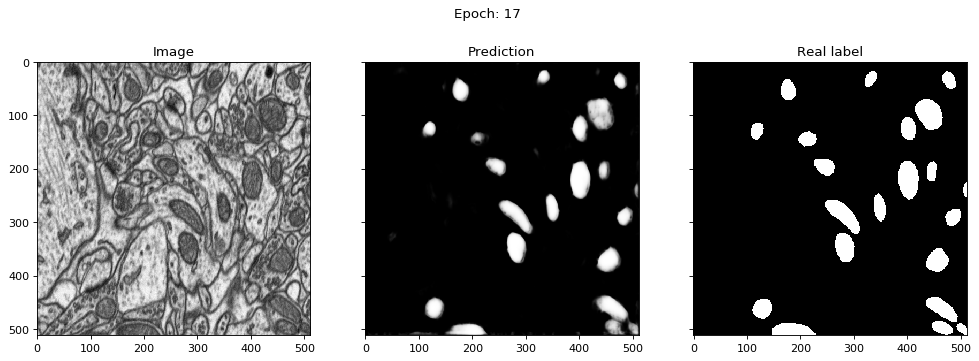

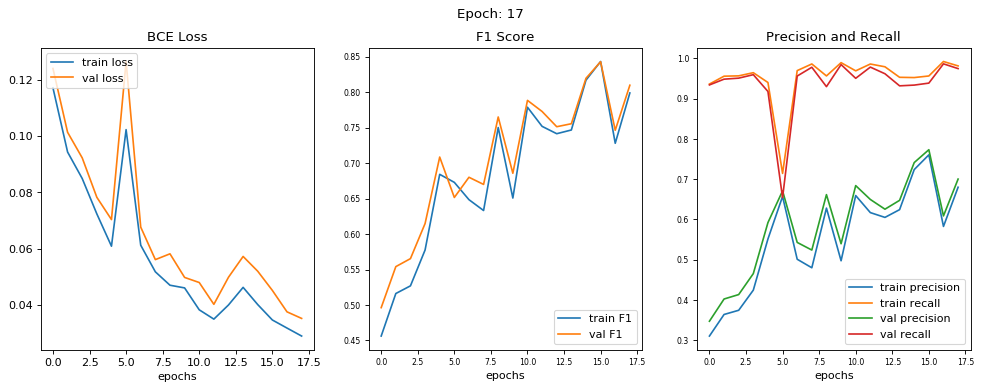

epoch [17/200] 
train loss = 0.0290, train f1 score = 0.7990 
train precision = 0.6801, train recall = 0.9813 

val loss = 0.0353, val f1 score = 0.8099 
val precision = 0.7004, val recall = 0.9746 




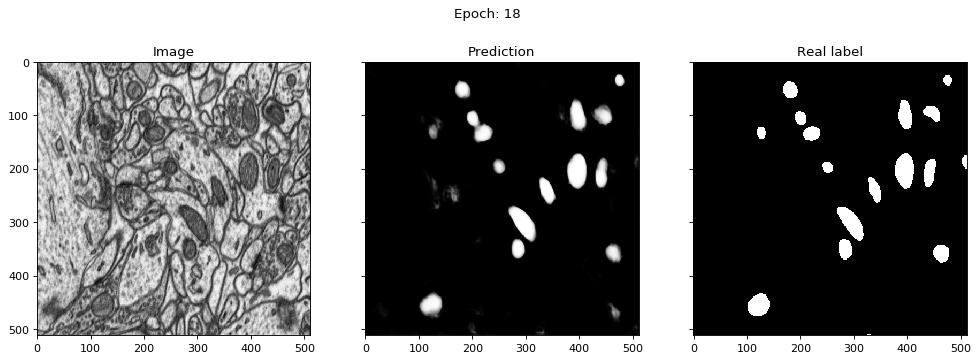

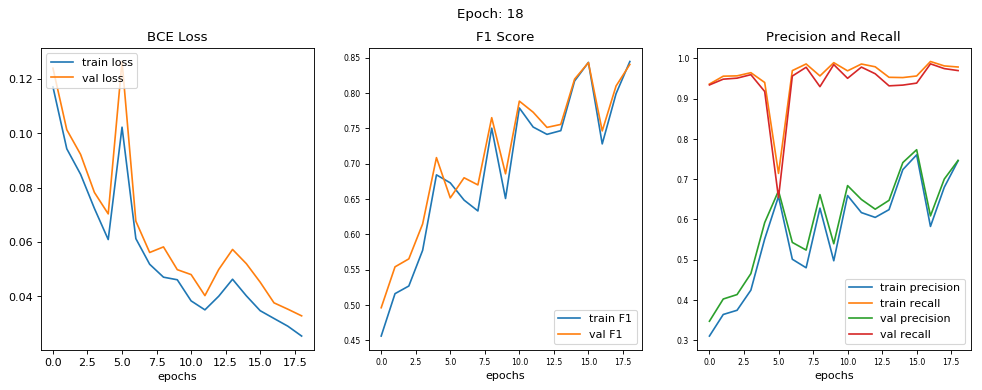

epoch [18/200] 
train loss = 0.0254, train f1 score = 0.8445 
train precision = 0.7458, train recall = 0.9786 

val loss = 0.0328, val f1 score = 0.8405 
val precision = 0.7467, val recall = 0.9697 




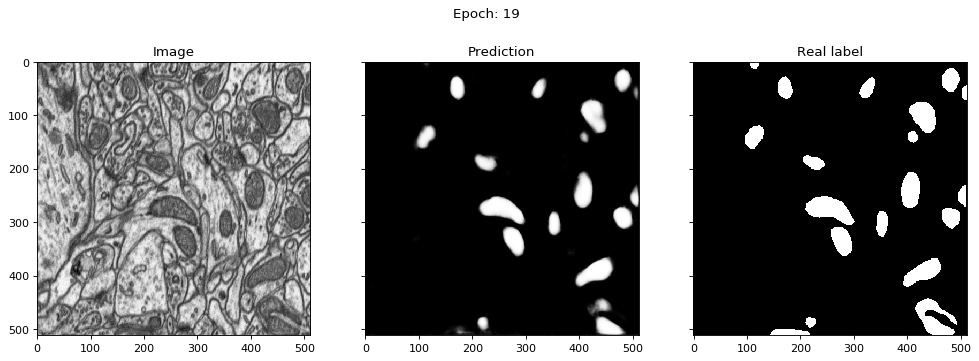

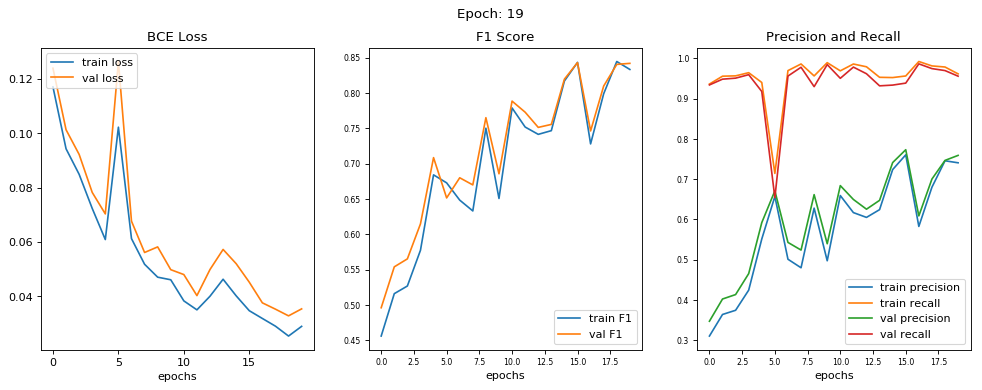

epoch [19/200] 
train loss = 0.0290, train f1 score = 0.8333 
train precision = 0.7408, train recall = 0.9616 

val loss = 0.0354, val f1 score = 0.8419 
val precision = 0.7592, val recall = 0.9558 




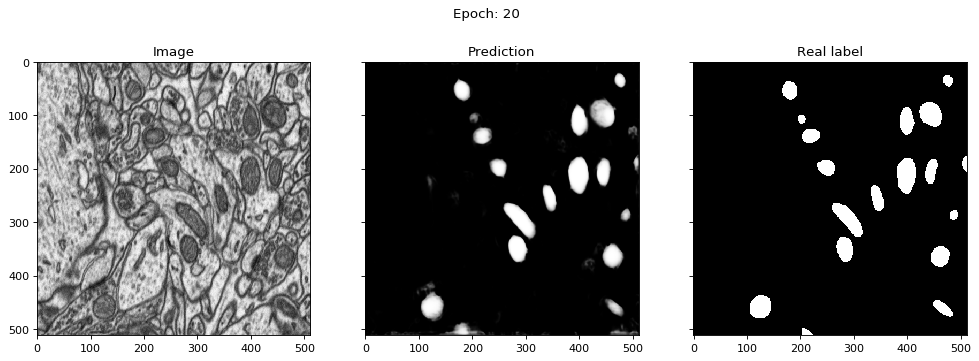

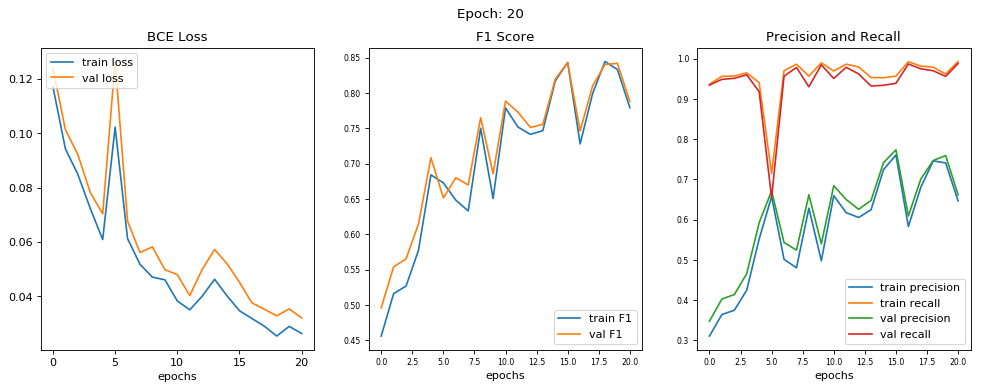

epoch [20/200] 
train loss = 0.0264, train f1 score = 0.7792 
train precision = 0.6463, train recall = 0.9927 

val loss = 0.0321, val f1 score = 0.7880 
val precision = 0.6614, val recall = 0.9878 




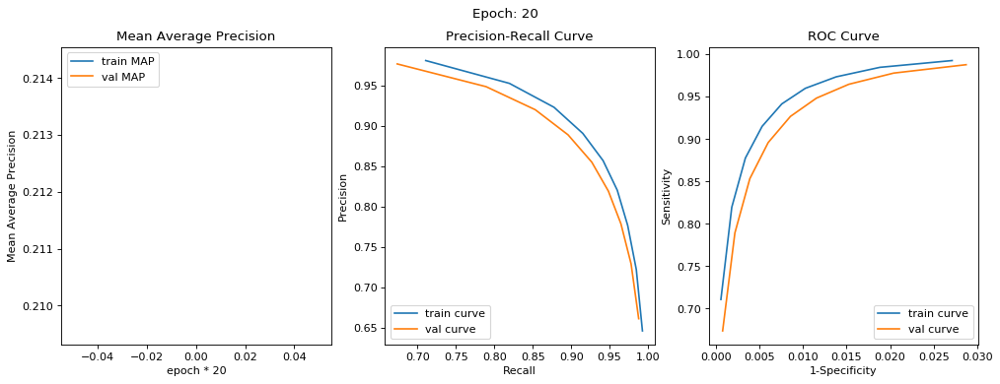

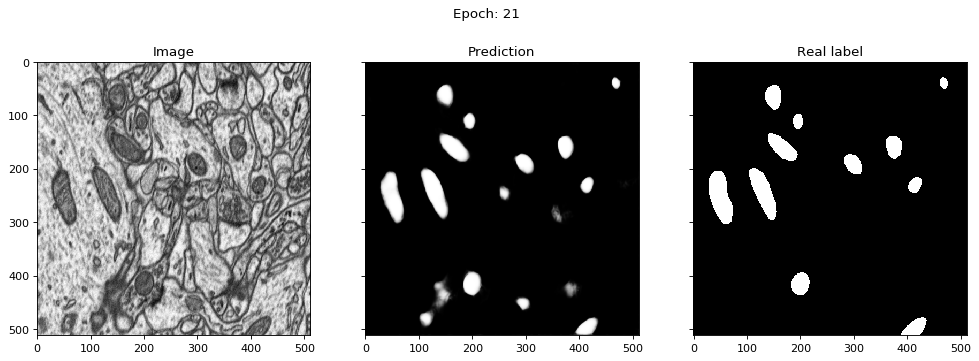

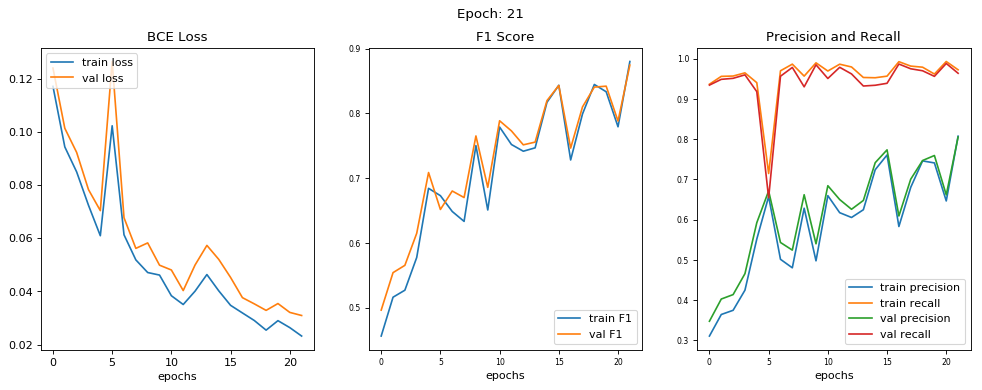

epoch [21/200] 
train loss = 0.0232, train f1 score = 0.8800 
train precision = 0.8072, train recall = 0.9722 

val loss = 0.0309, val f1 score = 0.8744 
val precision = 0.8050, val recall = 0.9635 




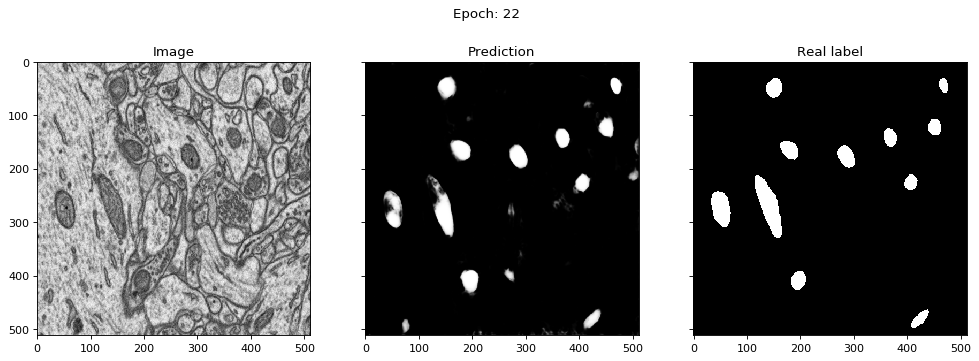

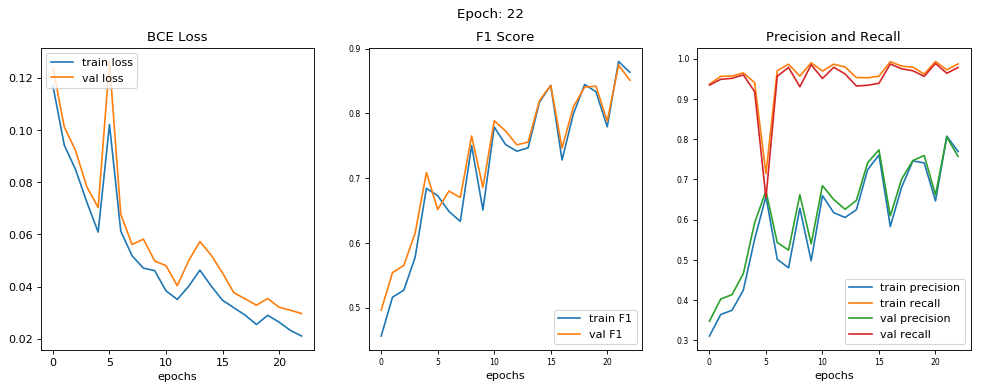

epoch [22/200] 
train loss = 0.0210, train f1 score = 0.8633 
train precision = 0.7691, train recall = 0.9868 

val loss = 0.0296, val f1 score = 0.8511 
val precision = 0.7568, val recall = 0.9779 




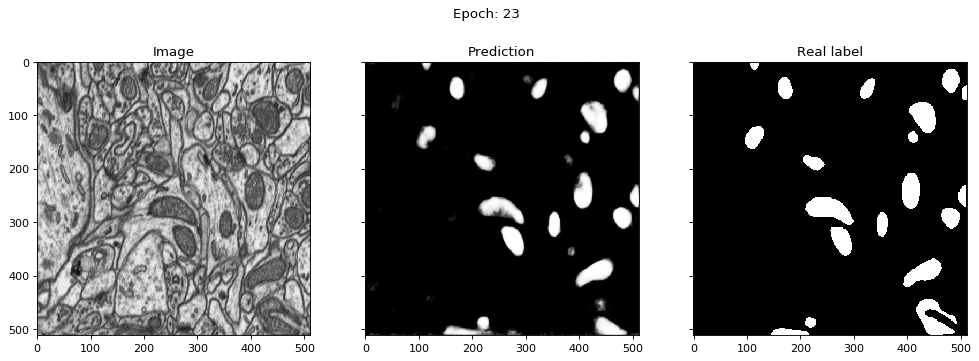

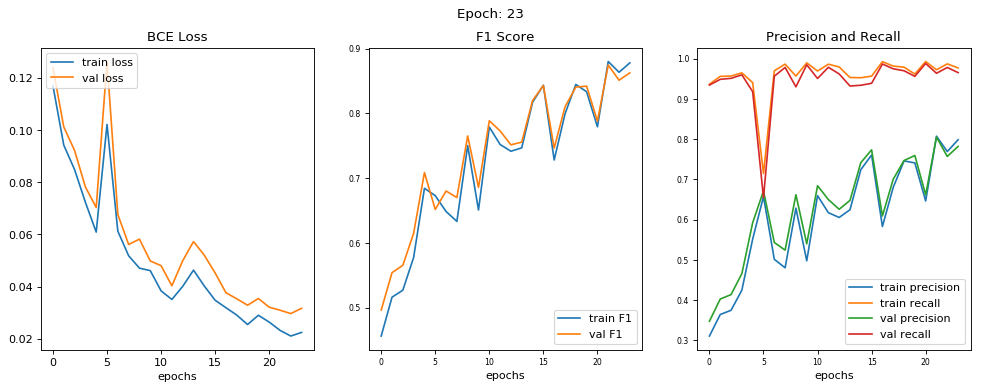

epoch [23/200] 
train loss = 0.0224, train f1 score = 0.8779 
train precision = 0.7982, train recall = 0.9768 

val loss = 0.0317, val f1 score = 0.8625 
val precision = 0.7818, val recall = 0.9651 




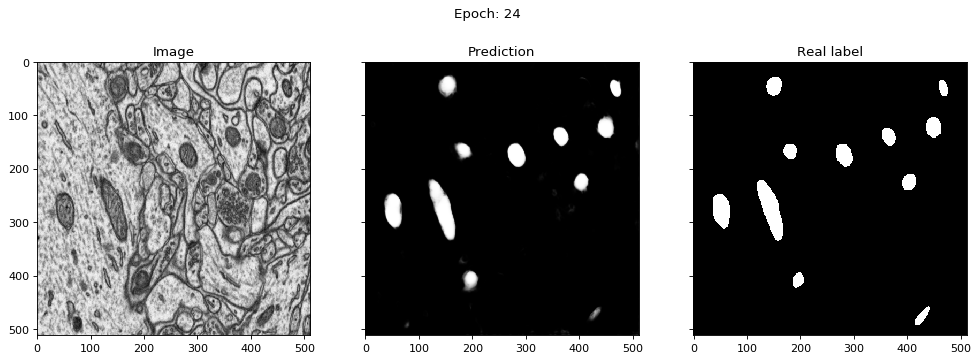

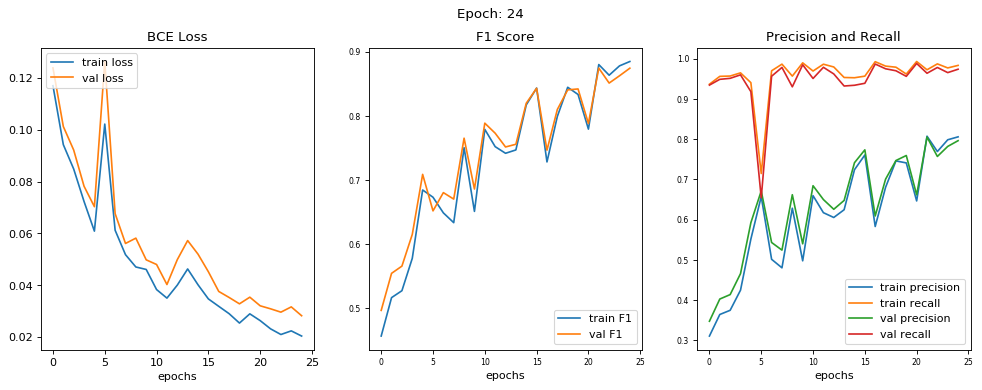

epoch [24/200] 
train loss = 0.0204, train f1 score = 0.8847 
train precision = 0.8055, train recall = 0.9831 

val loss = 0.0282, val f1 score = 0.8743 
val precision = 0.7960, val recall = 0.9736 




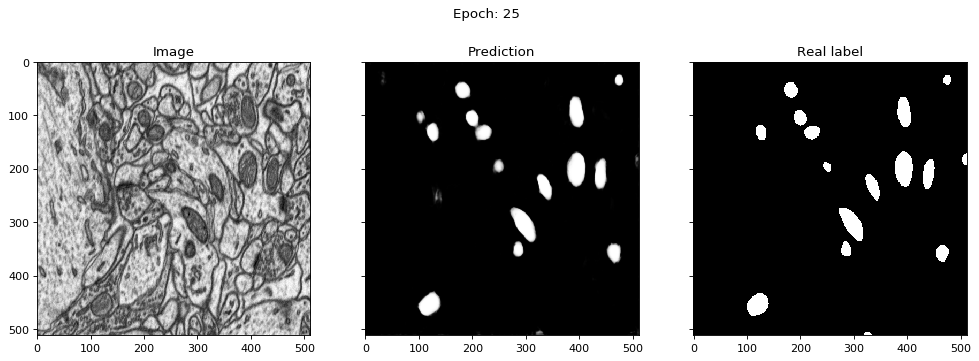

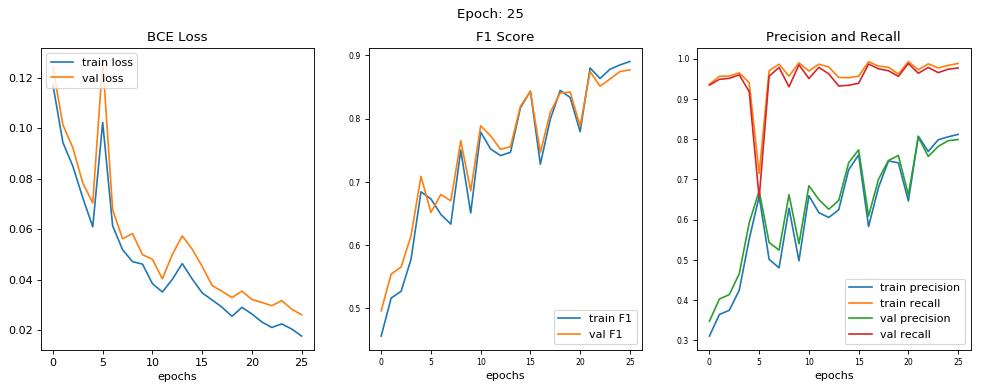

epoch [25/200] 
train loss = 0.0176, train f1 score = 0.8902 
train precision = 0.8117, train recall = 0.9879 

val loss = 0.0260, val f1 score = 0.8770 
val precision = 0.7988, val recall = 0.9766 




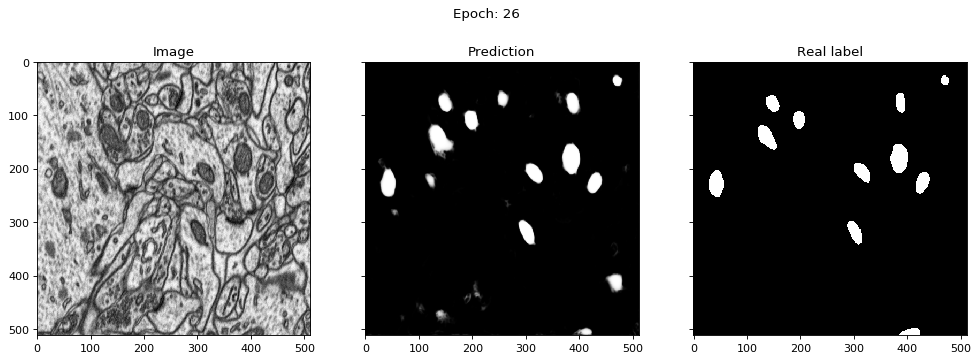

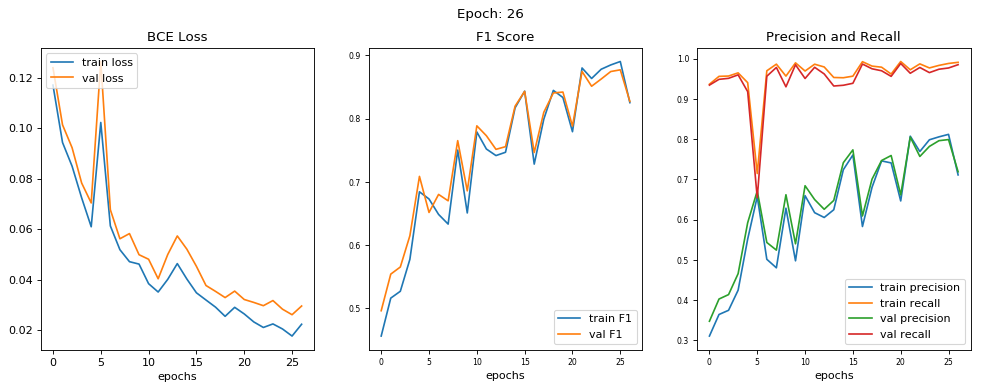

epoch [26/200] 
train loss = 0.0223, train f1 score = 0.8251 
train precision = 0.7109, train recall = 0.9907 

val loss = 0.0295, val f1 score = 0.8271 
val precision = 0.7188, val recall = 0.9848 




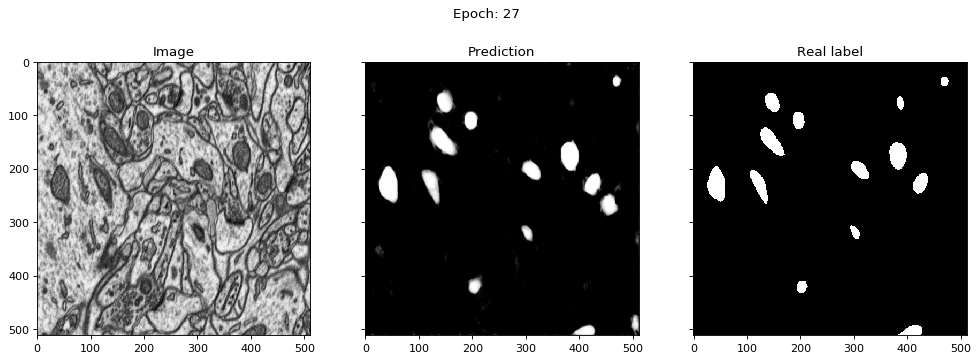

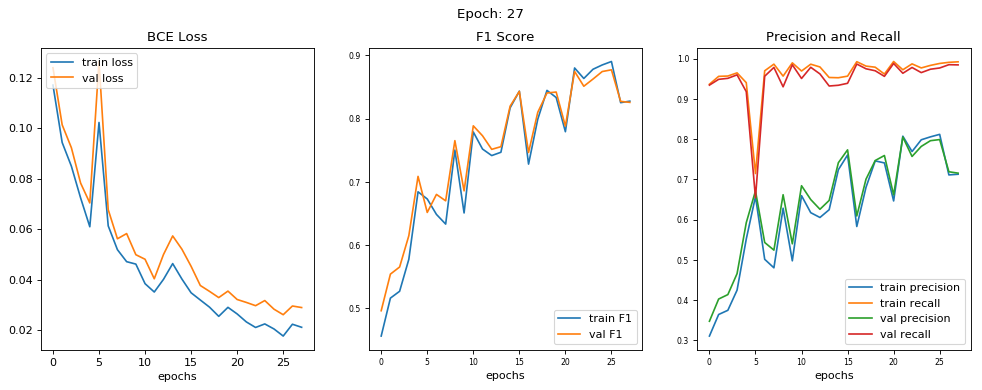

epoch [27/200] 
train loss = 0.0211, train f1 score = 0.8275 
train precision = 0.7126, train recall = 0.9919 

val loss = 0.0289, val f1 score = 0.8256 
val precision = 0.7153, val recall = 0.9843 




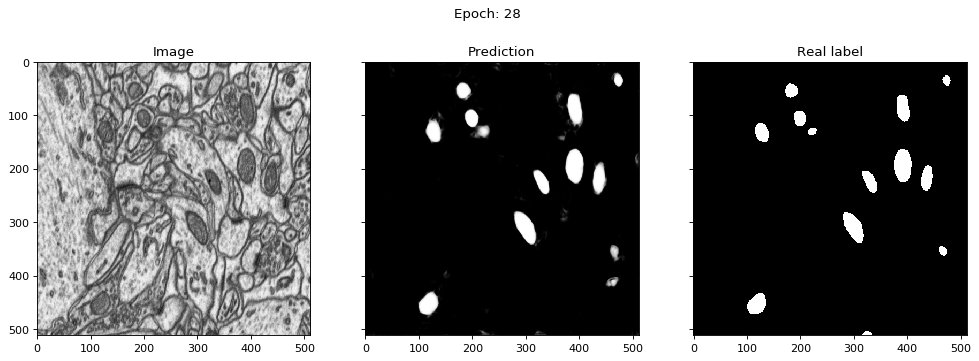

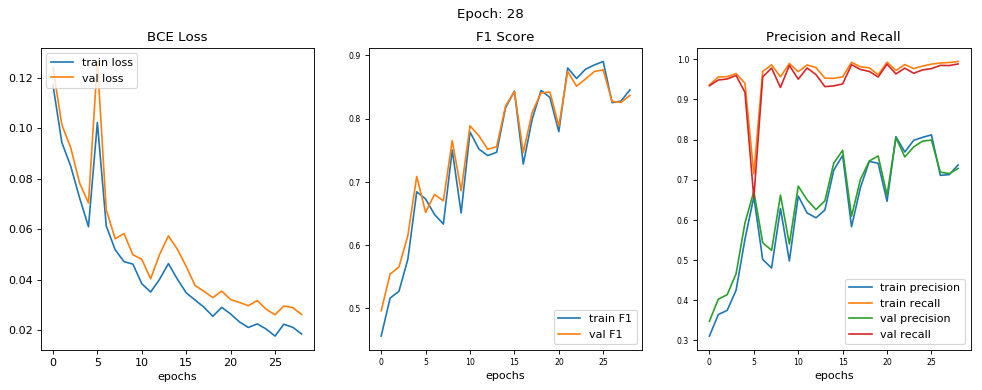

epoch [28/200] 
train loss = 0.0184, train f1 score = 0.8453 
train precision = 0.7368, train recall = 0.9945 

val loss = 0.0261, val f1 score = 0.8366 
val precision = 0.7281, val recall = 0.9884 




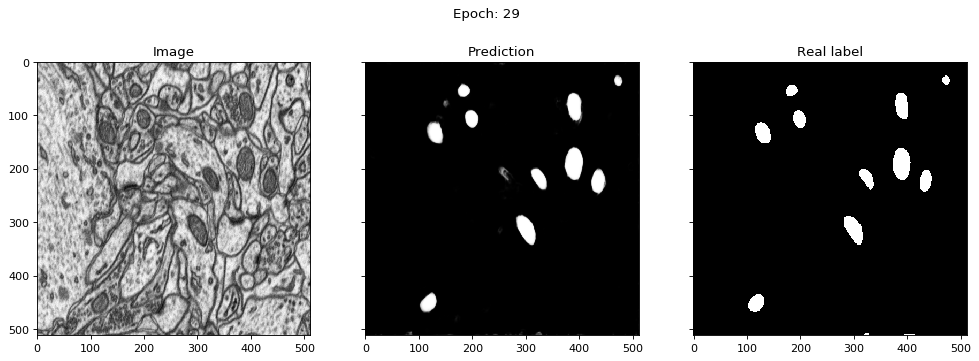

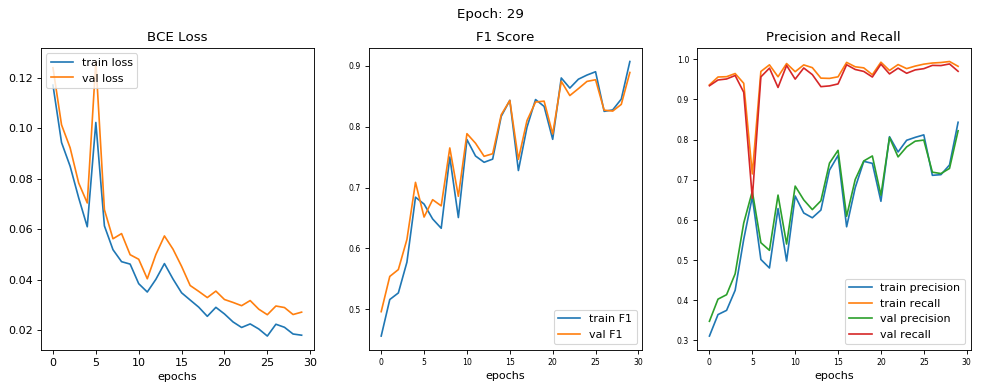

epoch [29/200] 
train loss = 0.0179, train f1 score = 0.9070 
train precision = 0.8431, train recall = 0.9825 

val loss = 0.0271, val f1 score = 0.8890 
val precision = 0.8220, val recall = 0.9701 




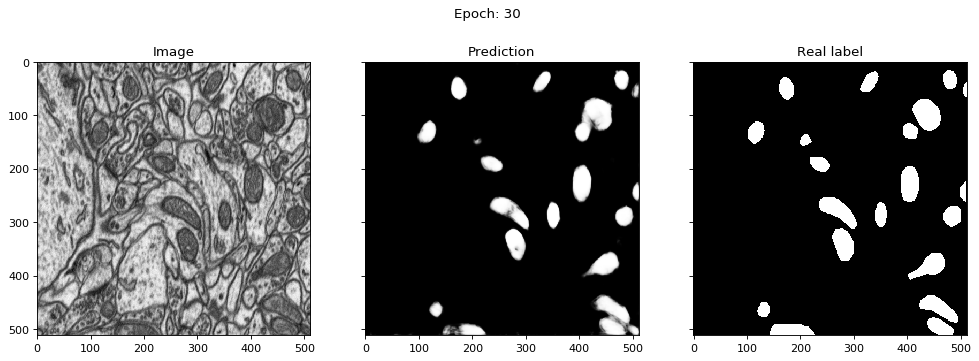

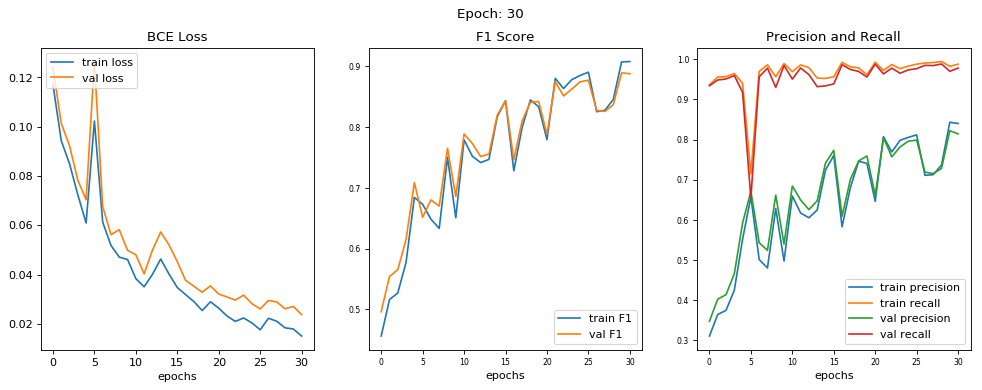

epoch [30/200] 
train loss = 0.0151, train f1 score = 0.9077 
train precision = 0.8401, train recall = 0.9879 

val loss = 0.0238, val f1 score = 0.8876 
val precision = 0.8142, val recall = 0.9781 




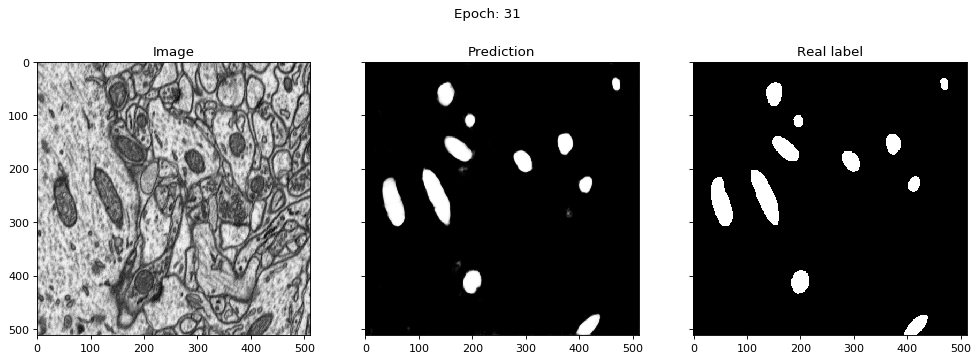

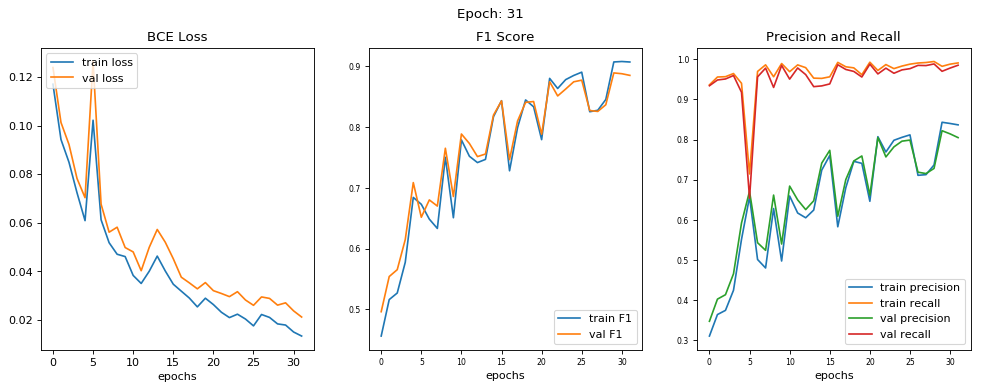

epoch [31/200] 
train loss = 0.0134, train f1 score = 0.9069 
train precision = 0.8366, train recall = 0.9909 

val loss = 0.0212, val f1 score = 0.8849 
val precision = 0.8049, val recall = 0.9852 




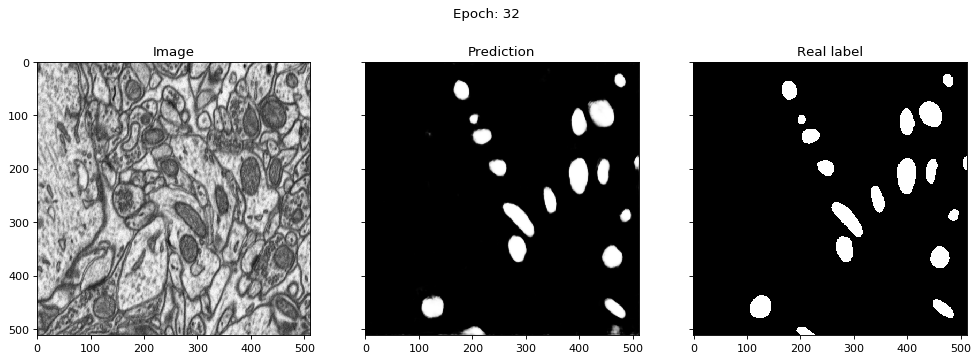

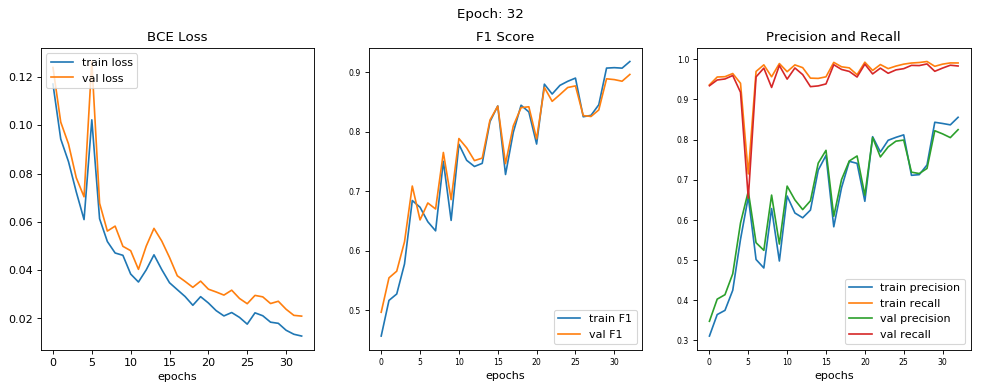

epoch [32/200] 
train loss = 0.0127, train f1 score = 0.9181 
train precision = 0.8555, train recall = 0.9908 

val loss = 0.0209, val f1 score = 0.8963 
val precision = 0.8247, val recall = 0.9833 




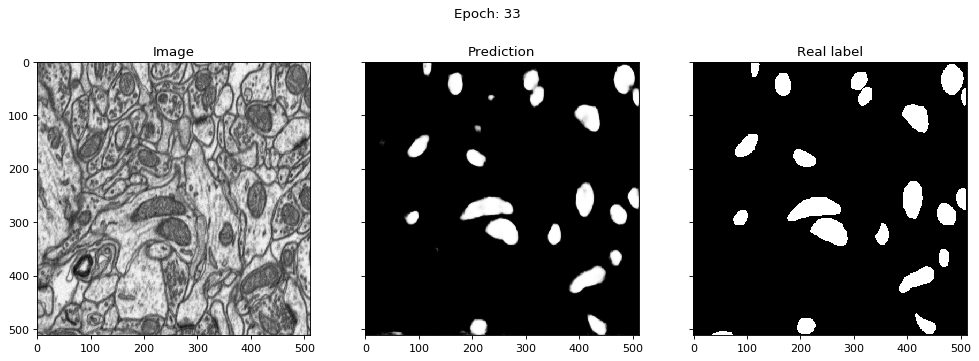

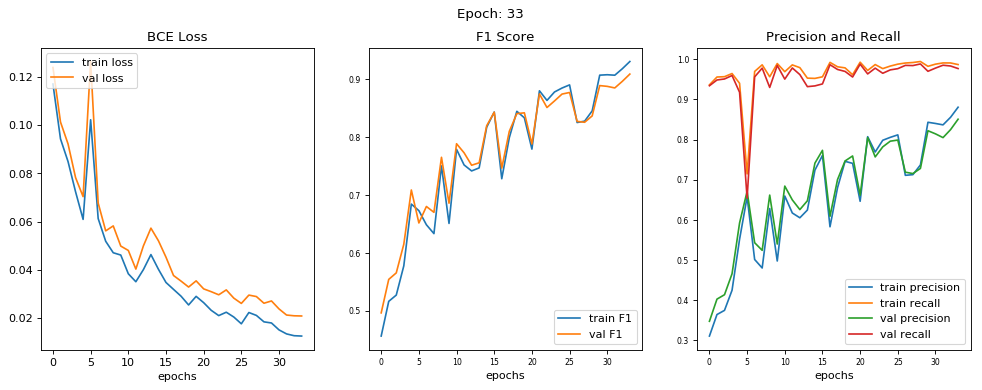

epoch [33/200] 
train loss = 0.0125, train f1 score = 0.9306 
train precision = 0.8806, train recall = 0.9868 

val loss = 0.0208, val f1 score = 0.9089 
val precision = 0.8507, val recall = 0.9769 




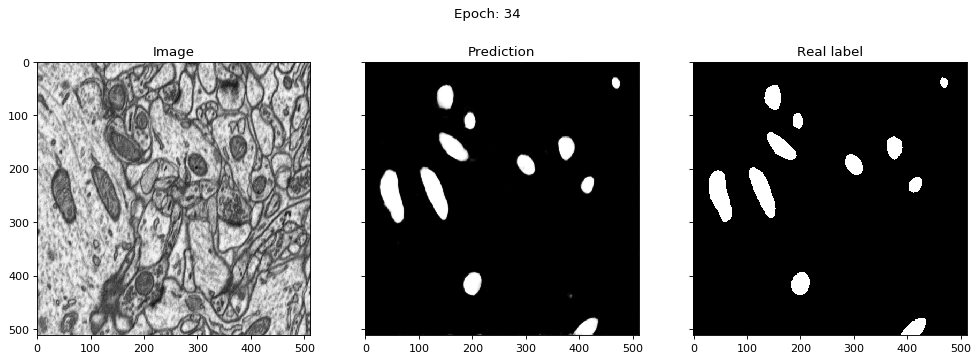

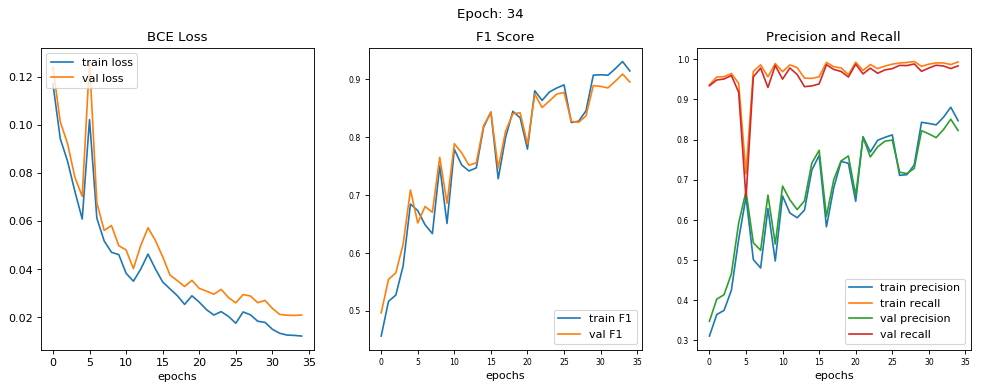

epoch [34/200] 
train loss = 0.0122, train f1 score = 0.9142 
train precision = 0.8471, train recall = 0.9933 

val loss = 0.0210, val f1 score = 0.8952 
val precision = 0.8226, val recall = 0.9835 




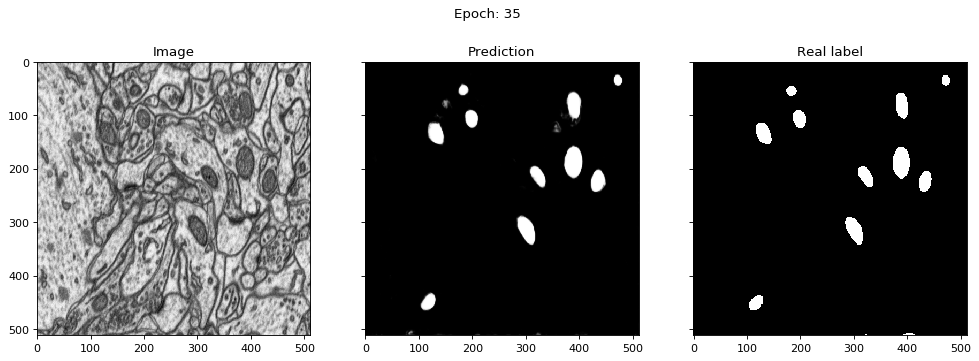

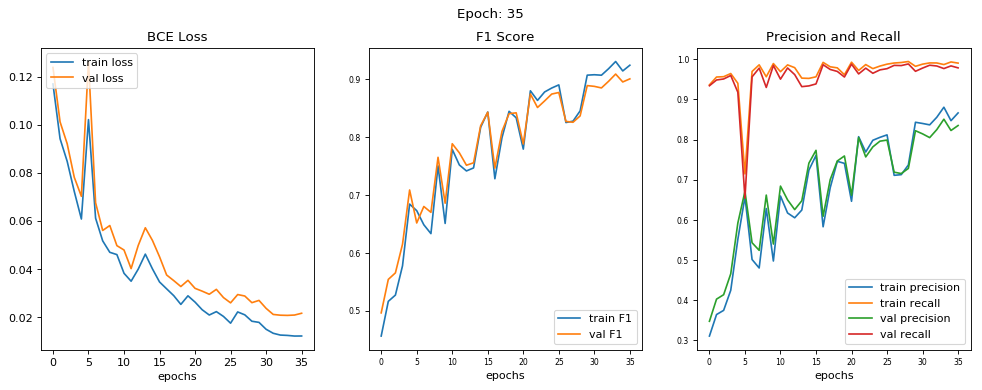

epoch [35/200] 
train loss = 0.0123, train f1 score = 0.9242 
train precision = 0.8664, train recall = 0.9905 

val loss = 0.0217, val f1 score = 0.9006 
val precision = 0.8350, val recall = 0.9786 




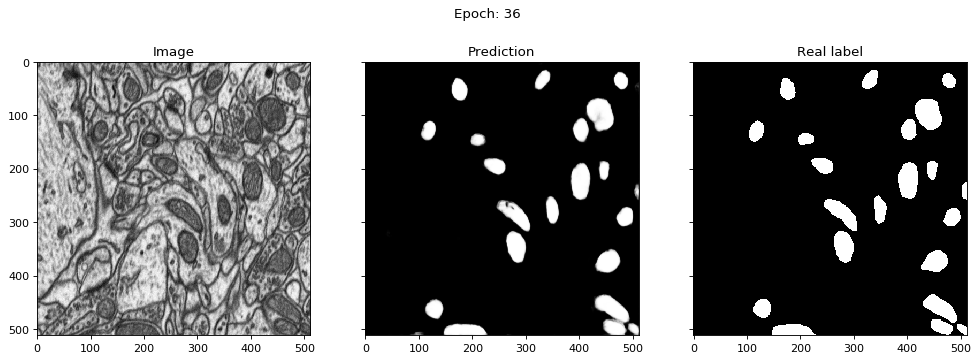

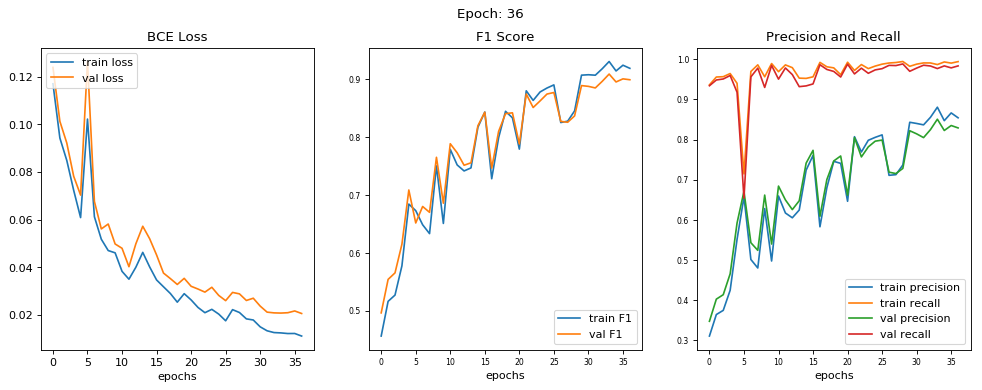

epoch [36/200] 
train loss = 0.0112, train f1 score = 0.9188 
train precision = 0.8542, train recall = 0.9942 

val loss = 0.0207, val f1 score = 0.8991 
val precision = 0.8290, val recall = 0.9835 




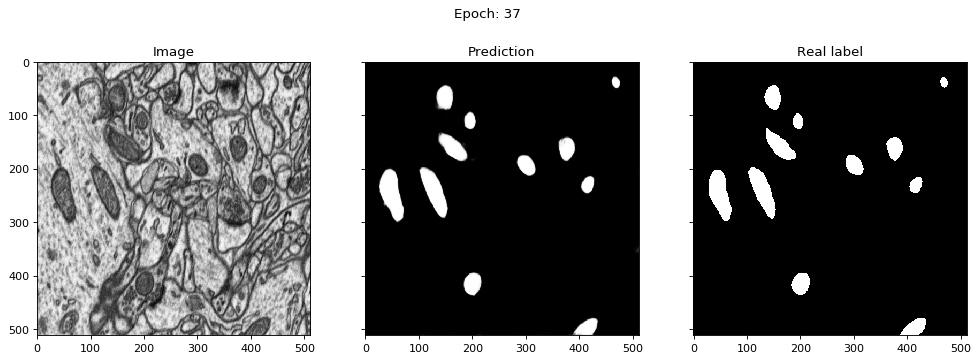

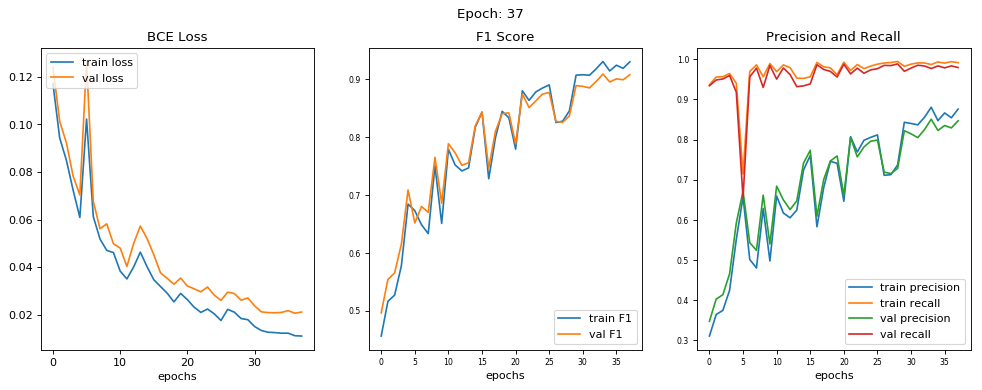

epoch [37/200] 
train loss = 0.0111, train f1 score = 0.9300 
train precision = 0.8759, train recall = 0.9915 

val loss = 0.0211, val f1 score = 0.9077 
val precision = 0.8468, val recall = 0.9795 




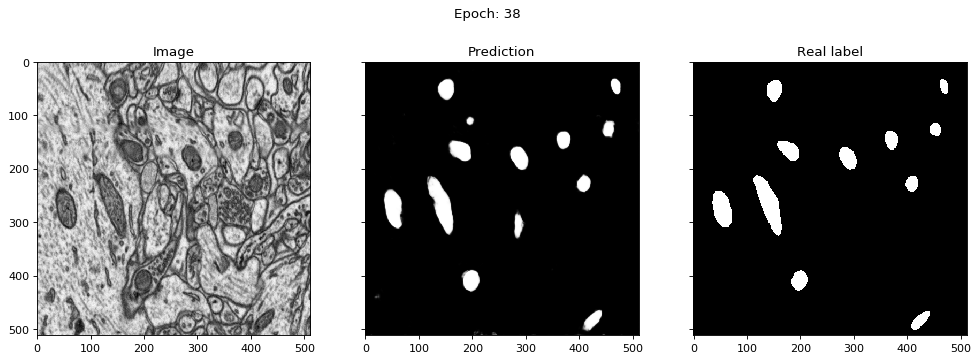

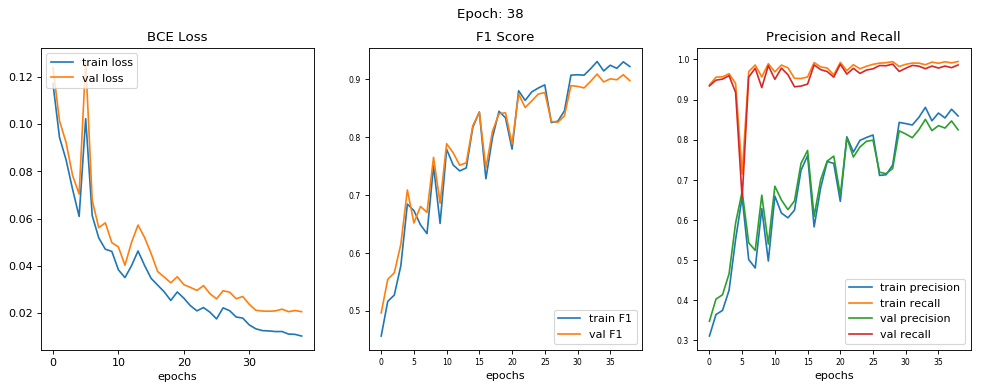

epoch [38/200] 
train loss = 0.0103, train f1 score = 0.9219 
train precision = 0.8591, train recall = 0.9949 

val loss = 0.0206, val f1 score = 0.8974 
val precision = 0.8246, val recall = 0.9862 




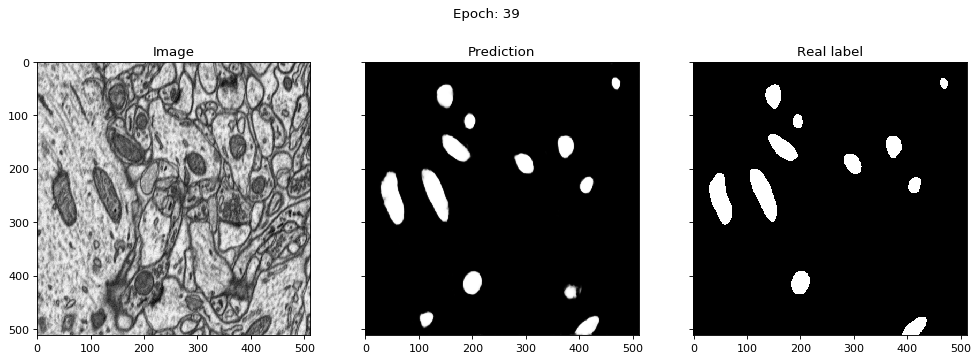

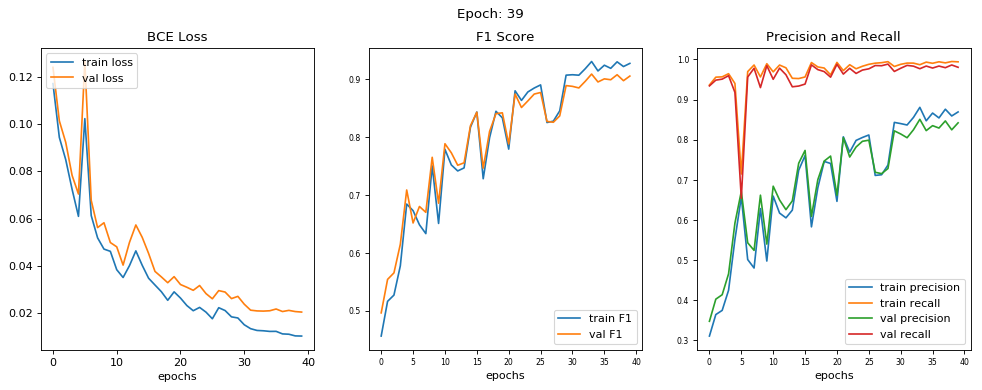

epoch [39/200] 
train loss = 0.0103, train f1 score = 0.9273 
train precision = 0.8692, train recall = 0.9940 

val loss = 0.0204, val f1 score = 0.9054 
val precision = 0.8420, val recall = 0.9805 




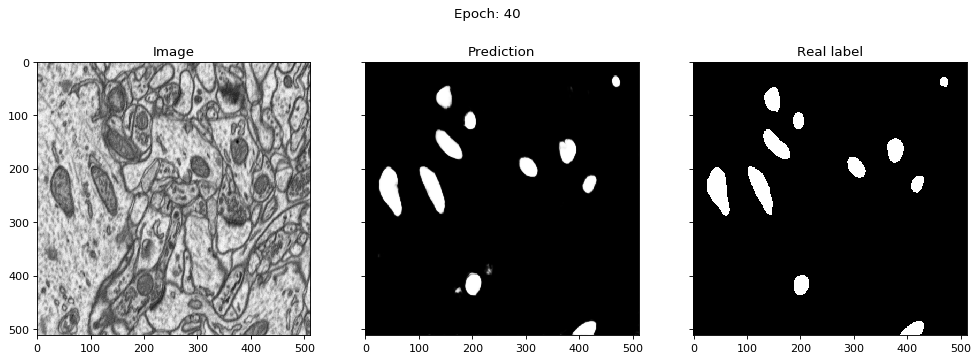

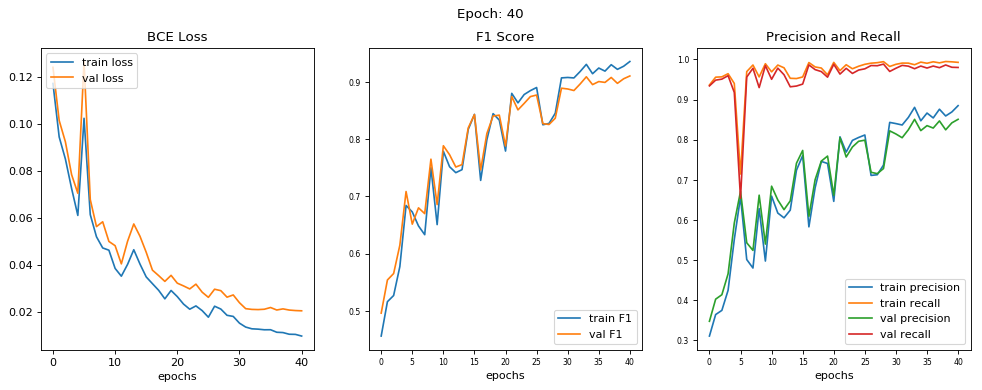

epoch [40/200] 
train loss = 0.0096, train f1 score = 0.9356 
train precision = 0.8848, train recall = 0.9927 

val loss = 0.0203, val f1 score = 0.9103 
val precision = 0.8508, val recall = 0.9800 




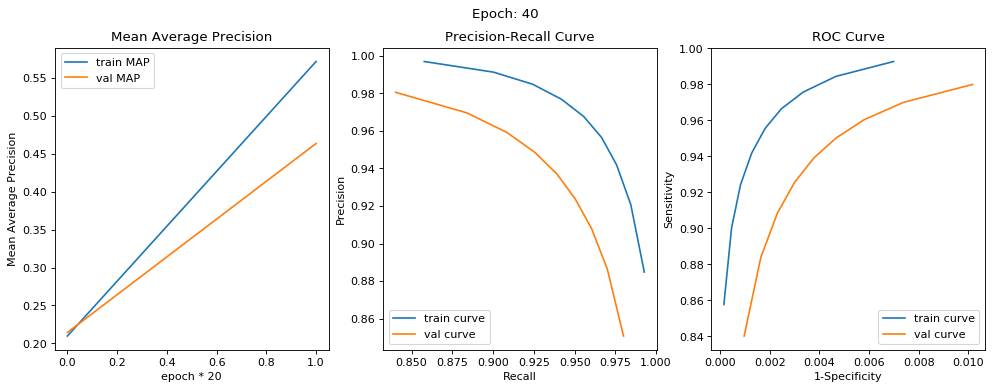

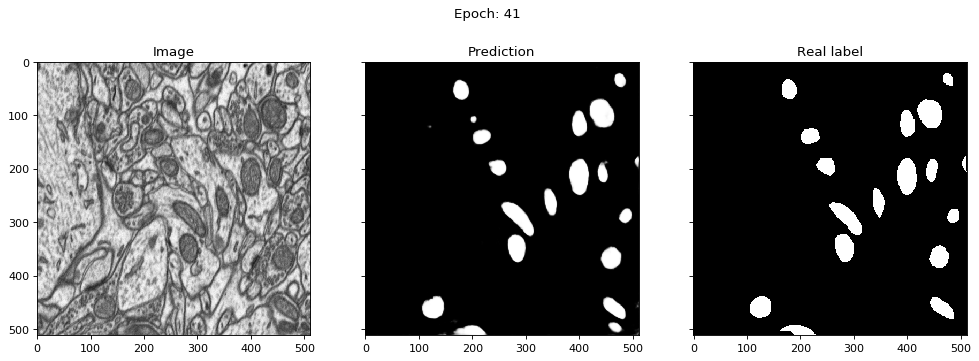

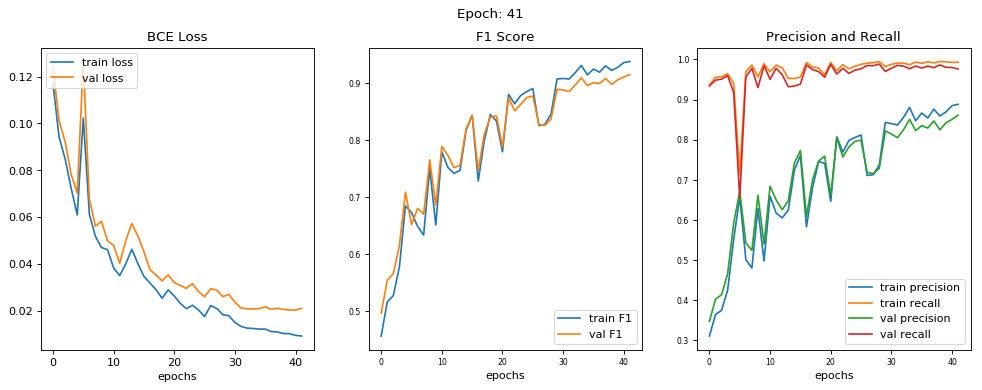

epoch [41/200] 
train loss = 0.0093, train f1 score = 0.9375 
train precision = 0.8881, train recall = 0.9929 

val loss = 0.0211, val f1 score = 0.9145 
val precision = 0.8612, val recall = 0.9762 




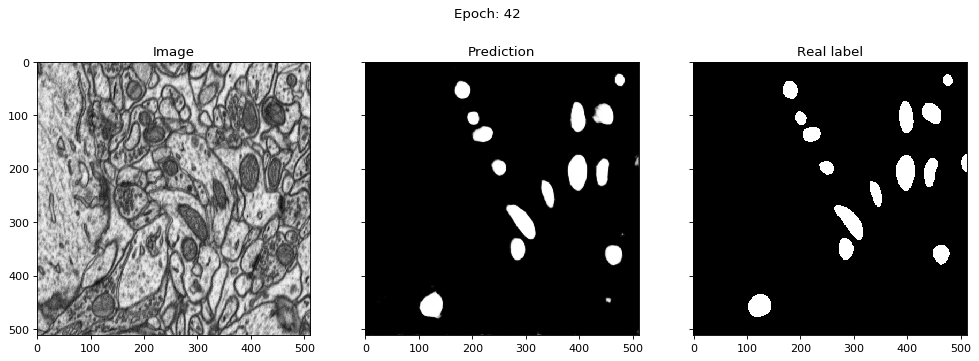

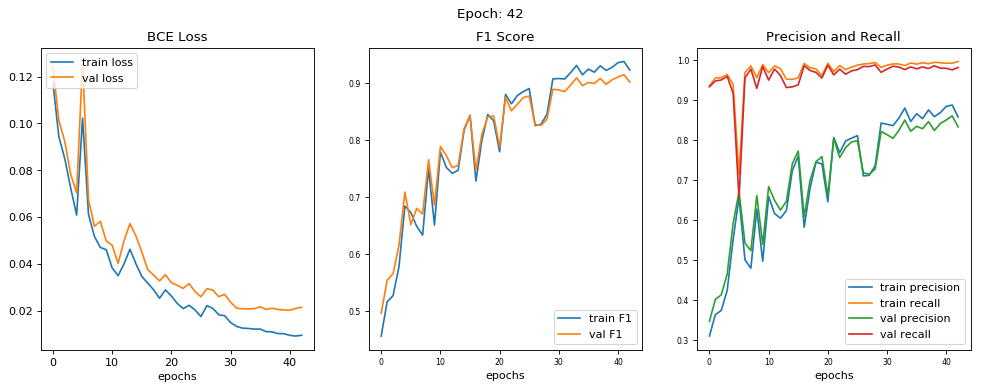

epoch [42/200] 
train loss = 0.0096, train f1 score = 0.9224 
train precision = 0.8583, train recall = 0.9970 

val loss = 0.0216, val f1 score = 0.9012 
val precision = 0.8335, val recall = 0.9822 




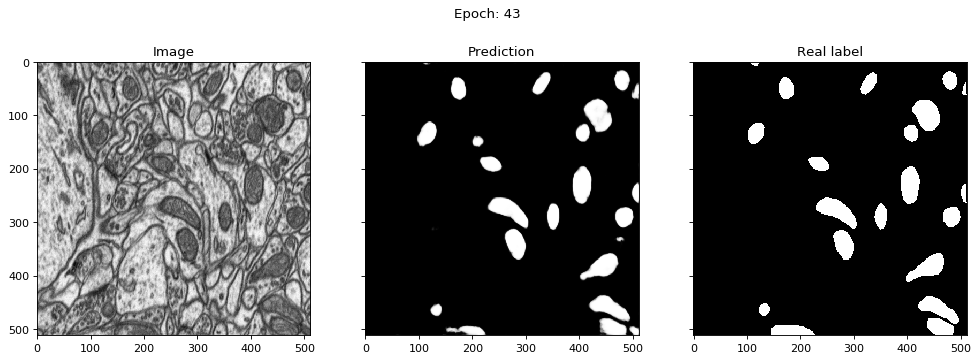

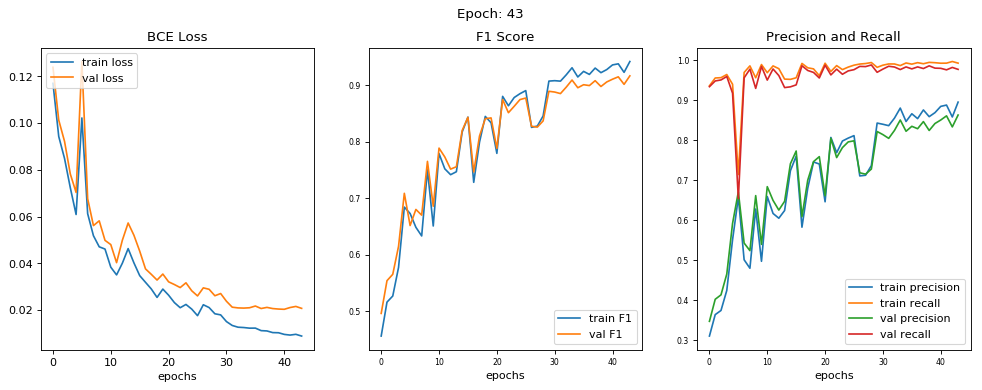

epoch [43/200] 
train loss = 0.0089, train f1 score = 0.9416 
train precision = 0.8955, train recall = 0.9929 

val loss = 0.0207, val f1 score = 0.9162 
val precision = 0.8632, val recall = 0.9774 




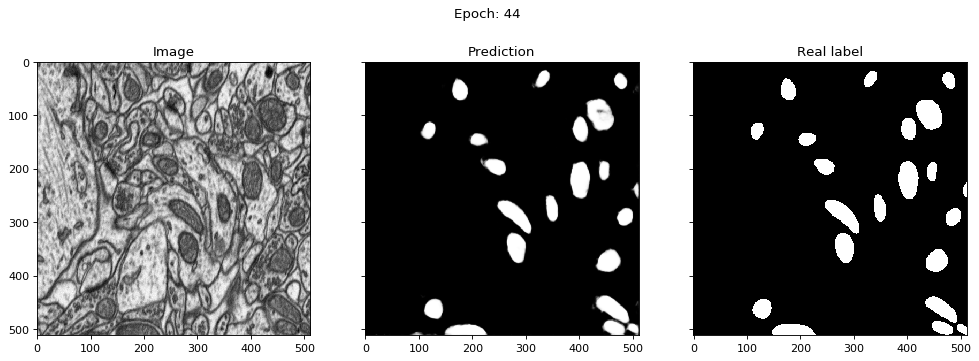

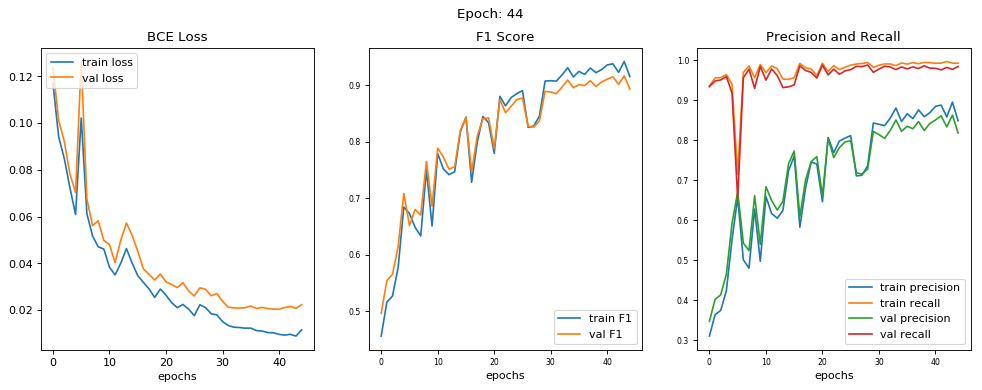

epoch [44/200] 
train loss = 0.0115, train f1 score = 0.9150 
train precision = 0.8489, train recall = 0.9927 

val loss = 0.0223, val f1 score = 0.8930 
val precision = 0.8184, val recall = 0.9845 




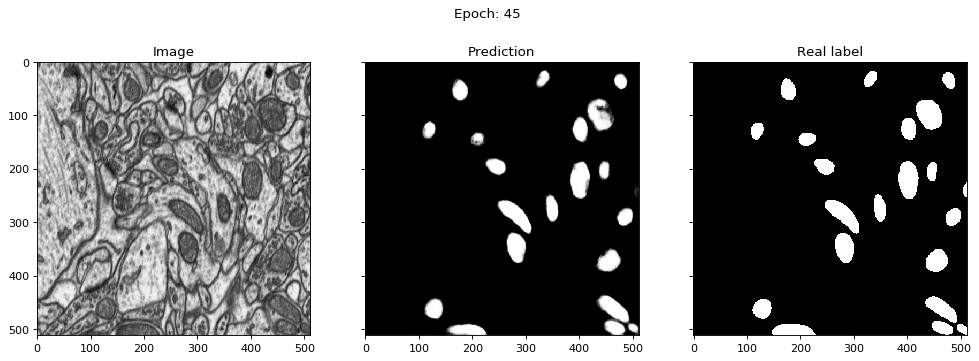

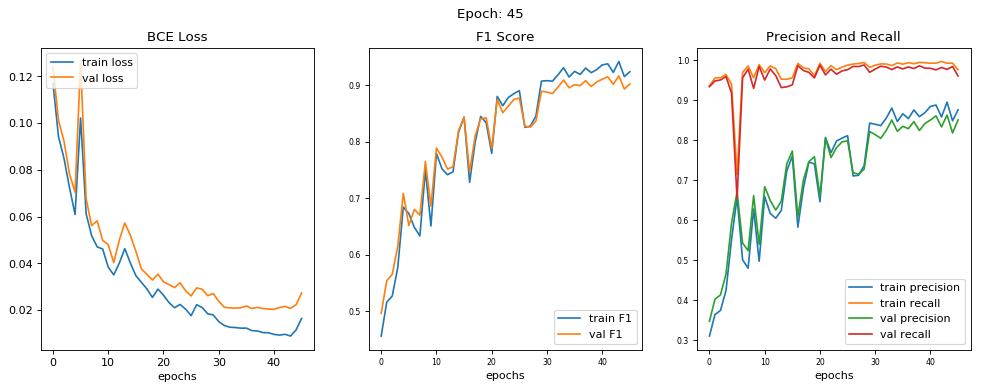

epoch [45/200] 
train loss = 0.0164, train f1 score = 0.9235 
train precision = 0.8764, train recall = 0.9765 

val loss = 0.0273, val f1 score = 0.9019 
val precision = 0.8511, val recall = 0.9608 




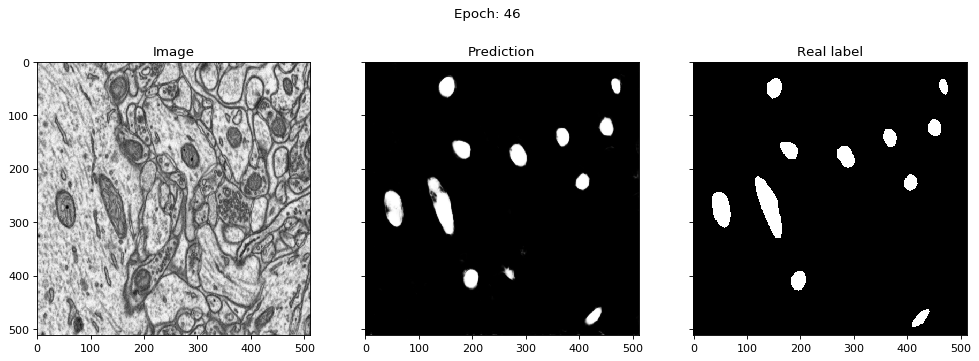

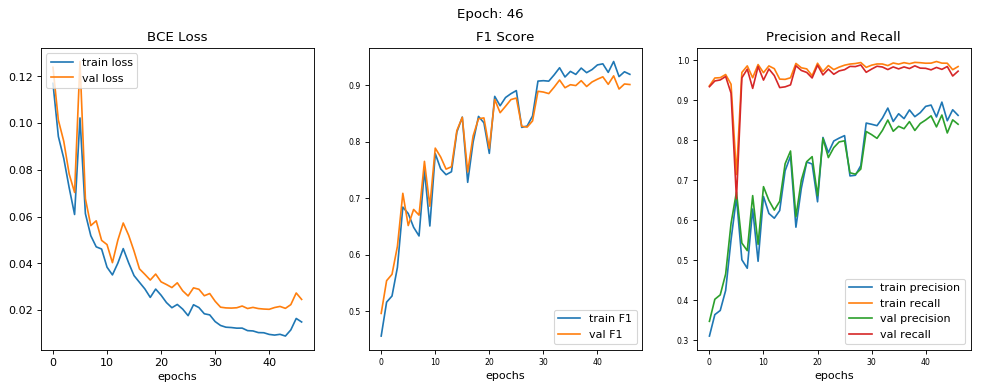

epoch [46/200] 
train loss = 0.0149, train f1 score = 0.9189 
train precision = 0.8624, train recall = 0.9844 

val loss = 0.0246, val f1 score = 0.9009 
val precision = 0.8402, val recall = 0.9729 




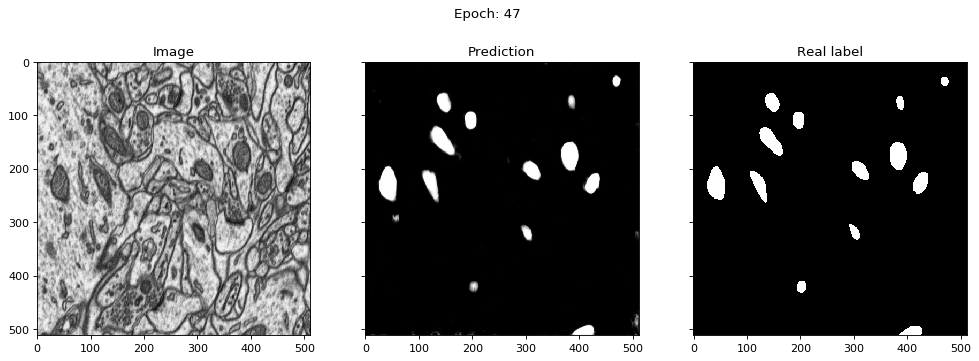

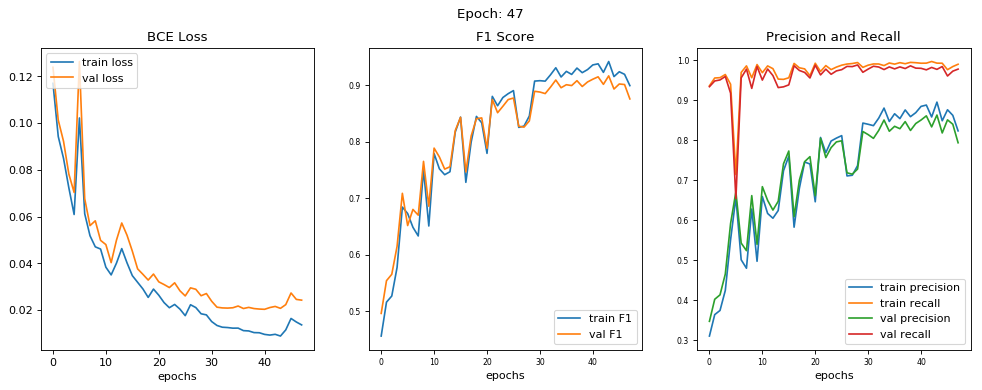

epoch [47/200] 
train loss = 0.0136, train f1 score = 0.8990 
train precision = 0.8236, train recall = 0.9902 

val loss = 0.0242, val f1 score = 0.8755 
val precision = 0.7939, val recall = 0.9780 




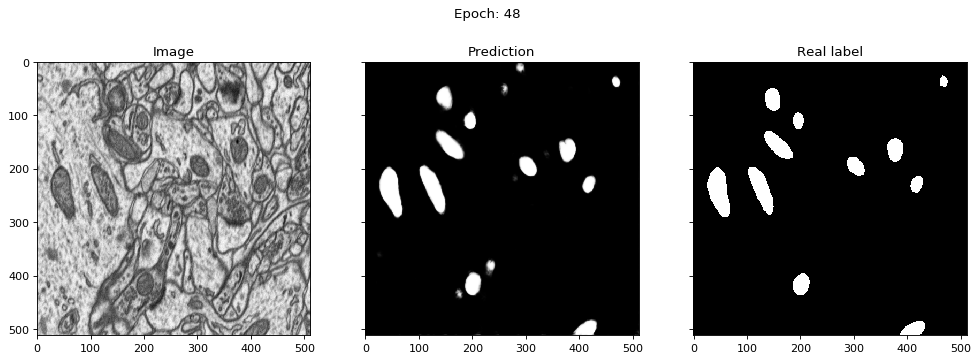

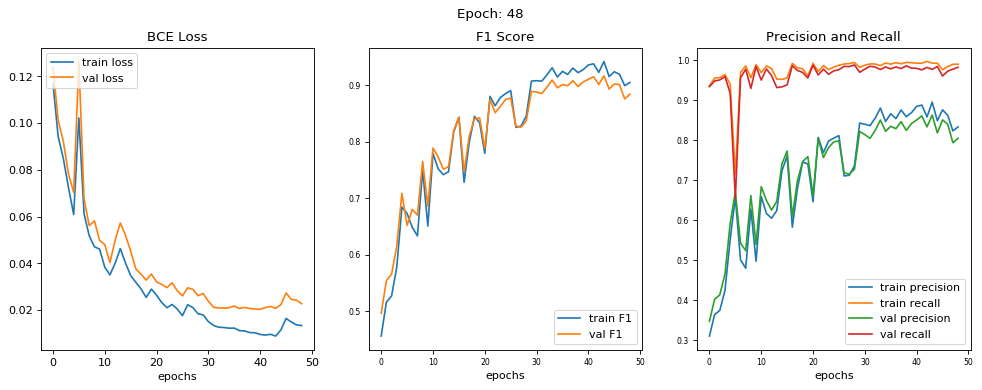

epoch [48/200] 
train loss = 0.0134, train f1 score = 0.9044 
train precision = 0.8335, train recall = 0.9903 

val loss = 0.0227, val f1 score = 0.8838 
val precision = 0.8051, val recall = 0.9826 




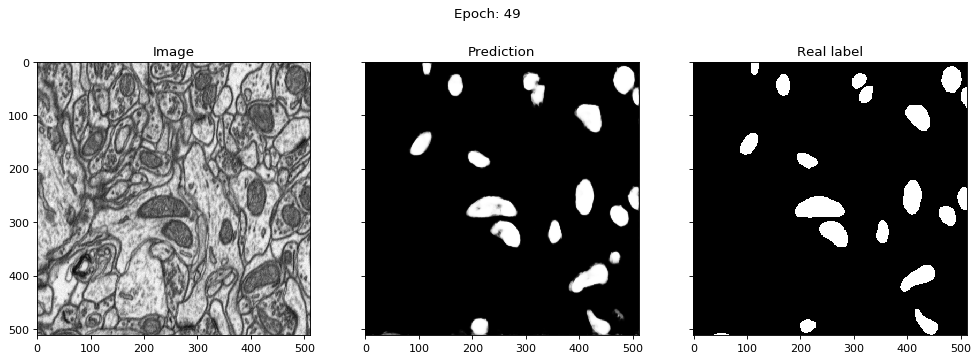

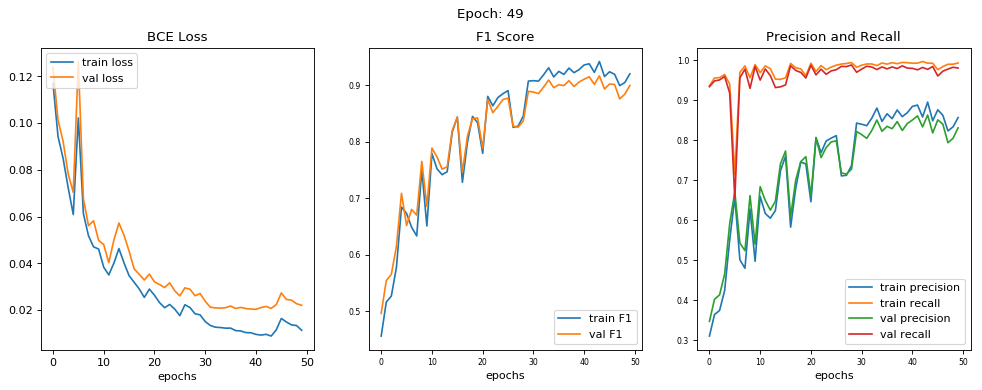

epoch [49/200] 
train loss = 0.0113, train f1 score = 0.9198 
train precision = 0.8568, train recall = 0.9933 

val loss = 0.0221, val f1 score = 0.8992 
val precision = 0.8311, val recall = 0.9807 




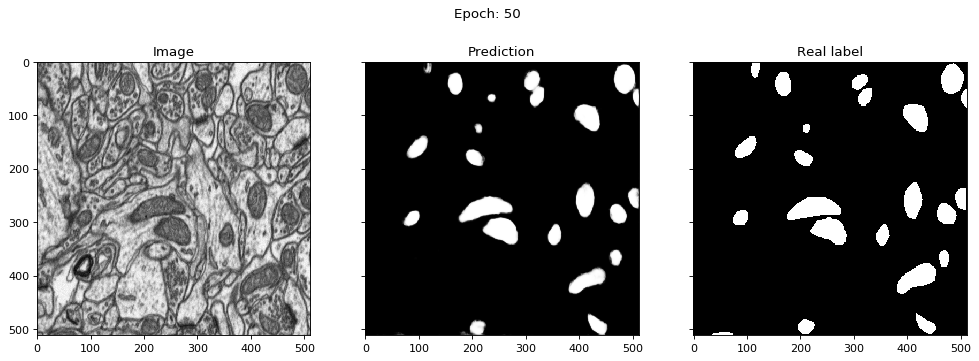

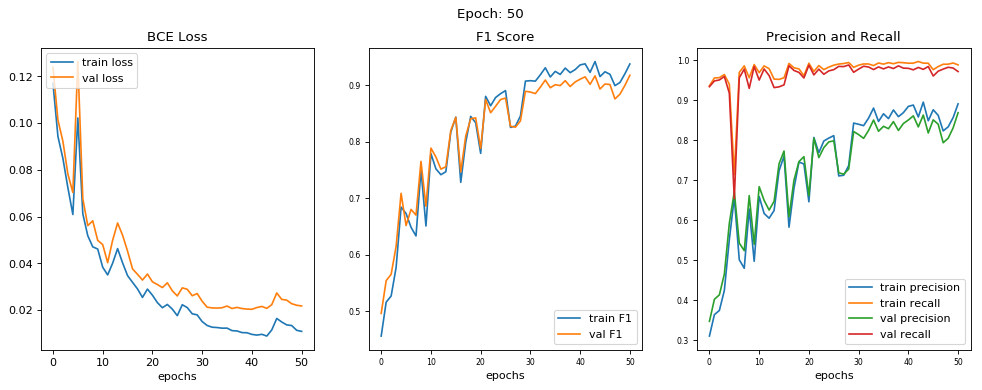

epoch [50/200] 
train loss = 0.0109, train f1 score = 0.9372 
train precision = 0.8912, train recall = 0.9885 

val loss = 0.0218, val f1 score = 0.9172 
val precision = 0.8690, val recall = 0.9719 




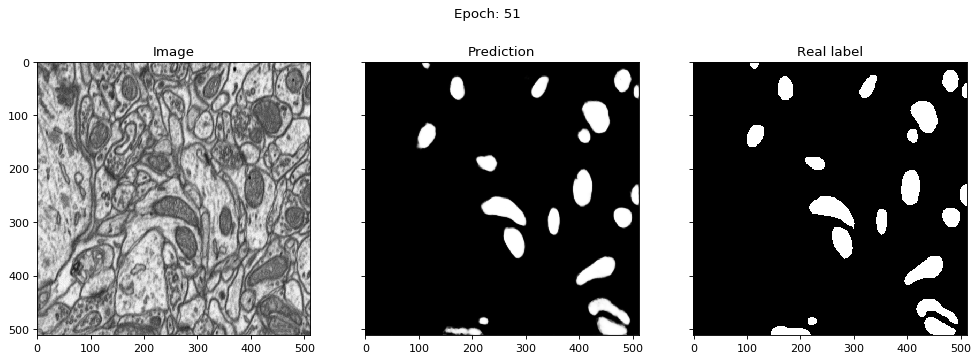

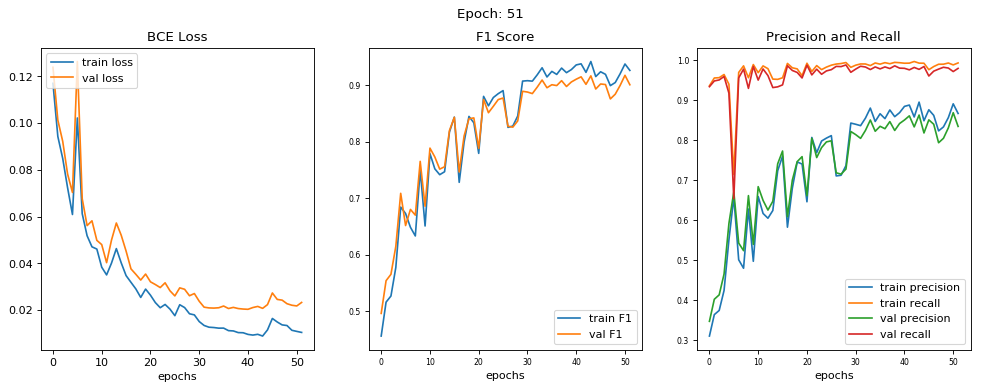

epoch [51/200] 
train loss = 0.0104, train f1 score = 0.9259 
train precision = 0.8671, train recall = 0.9935 

val loss = 0.0233, val f1 score = 0.9005 
val precision = 0.8347, val recall = 0.9799 




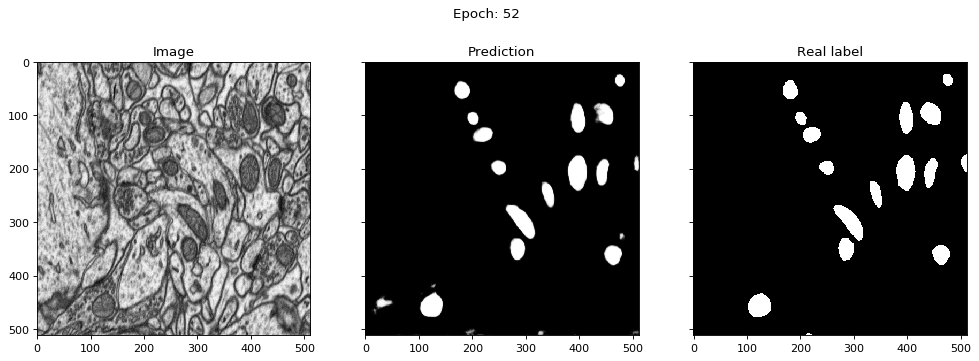

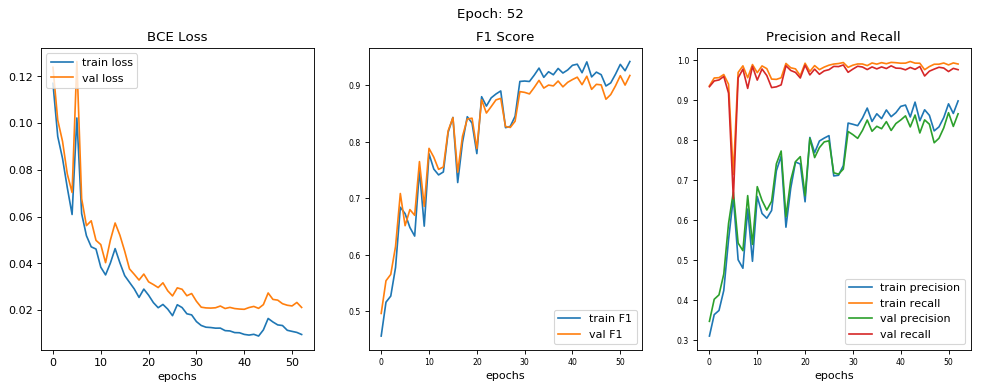

epoch [52/200] 
train loss = 0.0095, train f1 score = 0.9423 
train precision = 0.8985, train recall = 0.9907 

val loss = 0.0211, val f1 score = 0.9175 
val precision = 0.8663, val recall = 0.9766 




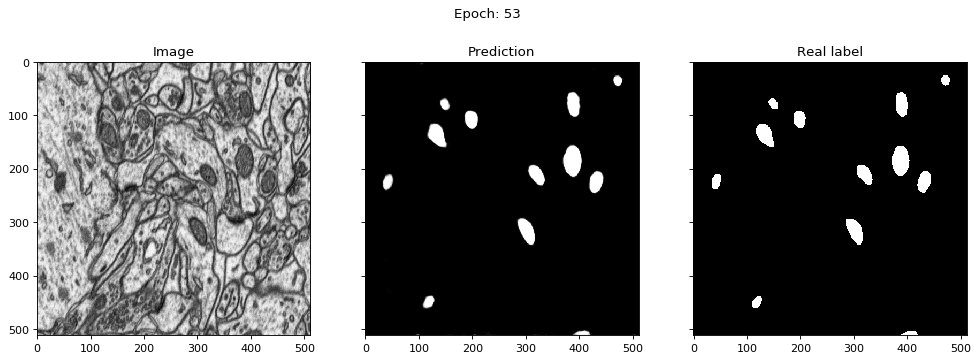

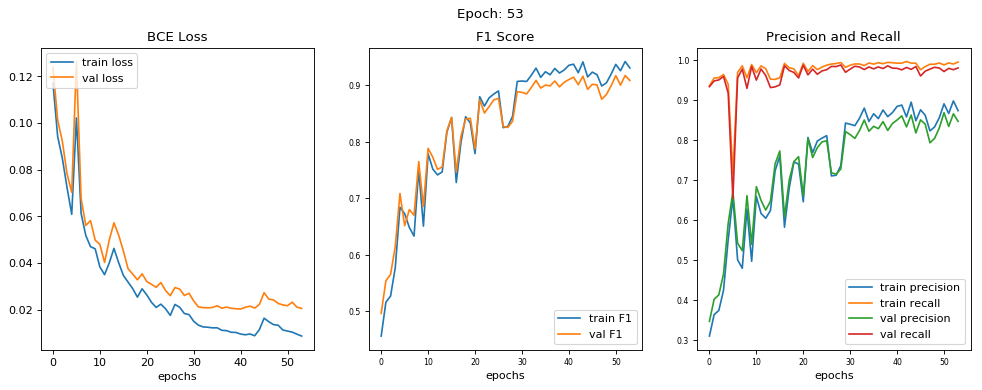

epoch [53/200] 
train loss = 0.0087, train f1 score = 0.9308 
train precision = 0.8741, train recall = 0.9956 

val loss = 0.0206, val f1 score = 0.9087 
val precision = 0.8474, val recall = 0.9809 




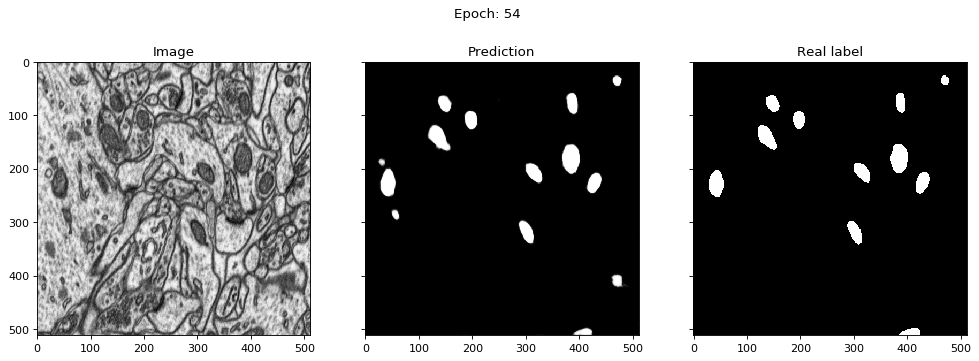

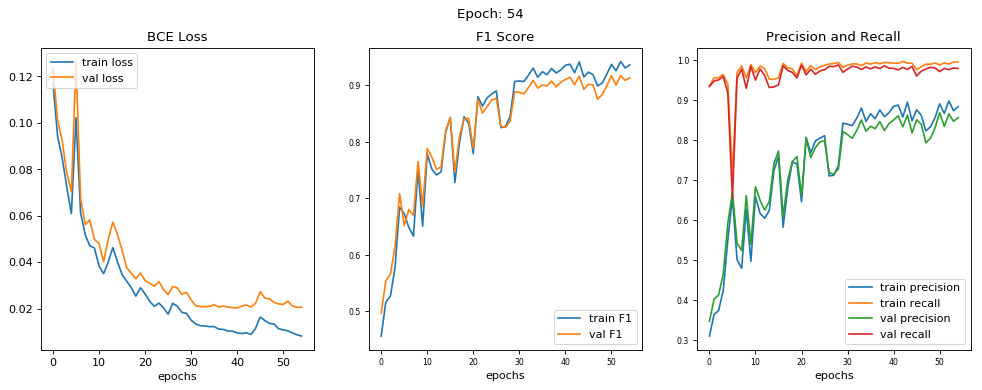

epoch [54/200] 
train loss = 0.0082, train f1 score = 0.9365 
train precision = 0.8843, train recall = 0.9955 

val loss = 0.0206, val f1 score = 0.9135 
val precision = 0.8568, val recall = 0.9795 




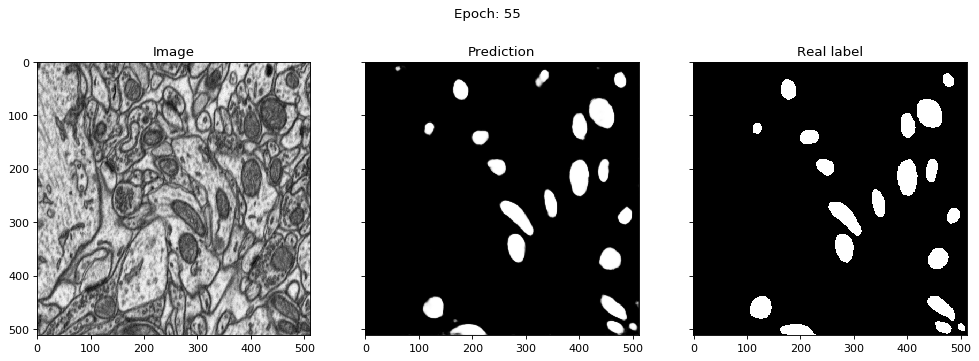

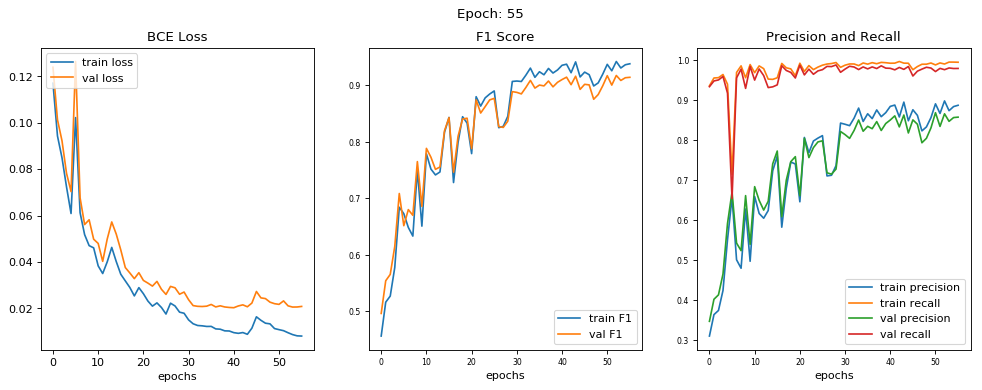

epoch [55/200] 
train loss = 0.0081, train f1 score = 0.9383 
train precision = 0.8876, train recall = 0.9952 

val loss = 0.0209, val f1 score = 0.9143 
val precision = 0.8579, val recall = 0.9797 




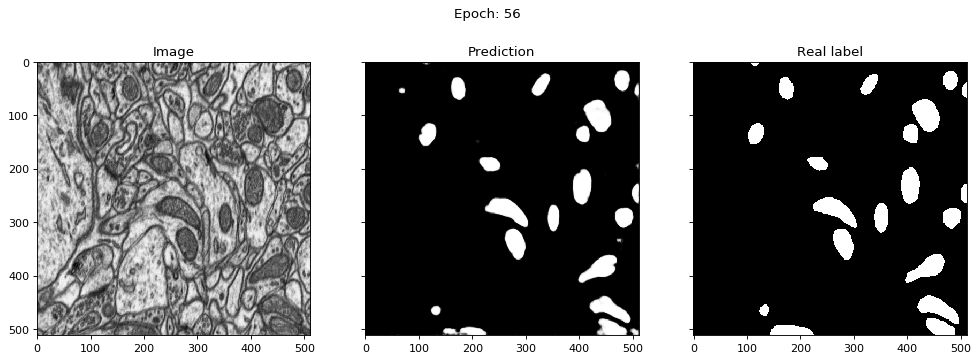

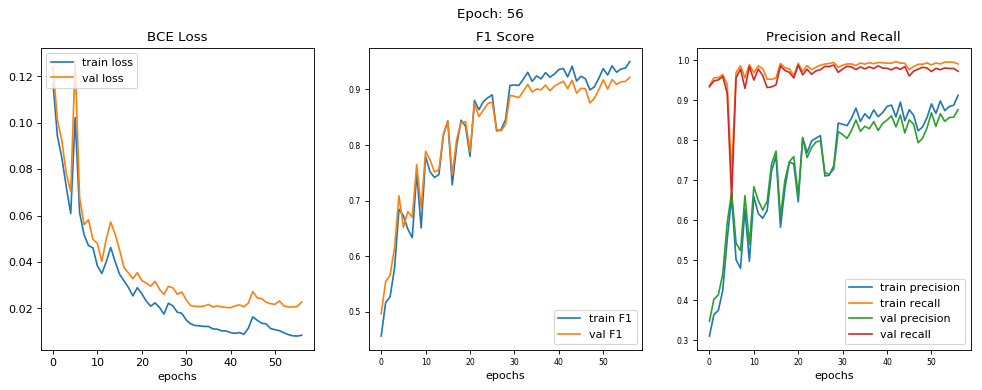

epoch [56/200] 
train loss = 0.0085, train f1 score = 0.9500 
train precision = 0.9125, train recall = 0.9910 

val loss = 0.0227, val f1 score = 0.9216 
val precision = 0.8767, val recall = 0.9726 




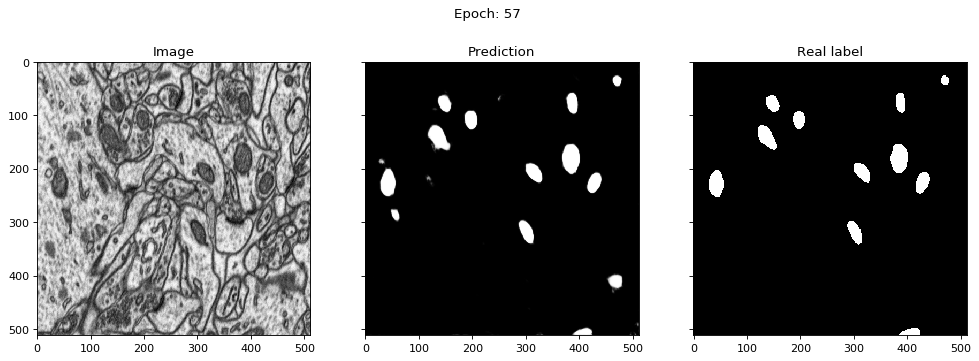

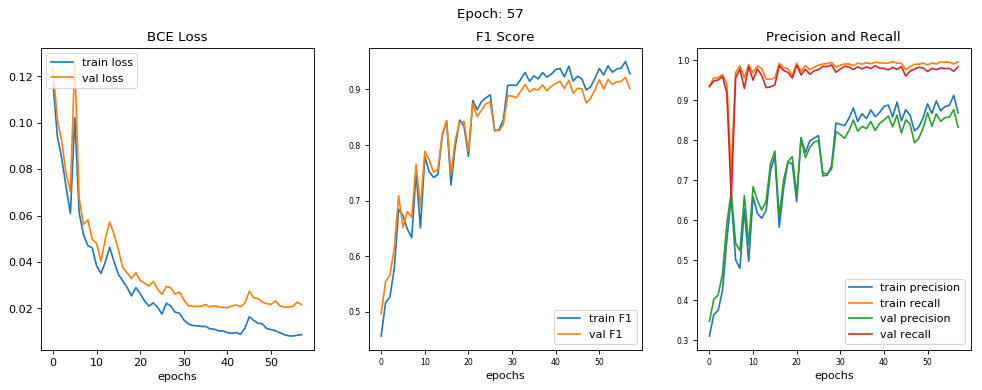

epoch [57/200] 
train loss = 0.0087, train f1 score = 0.9278 
train precision = 0.8683, train recall = 0.9963 

val loss = 0.0216, val f1 score = 0.9015 
val precision = 0.8330, val recall = 0.9838 




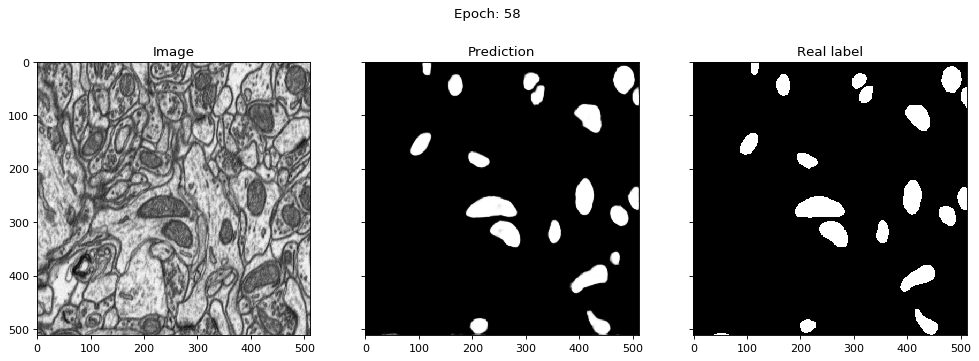

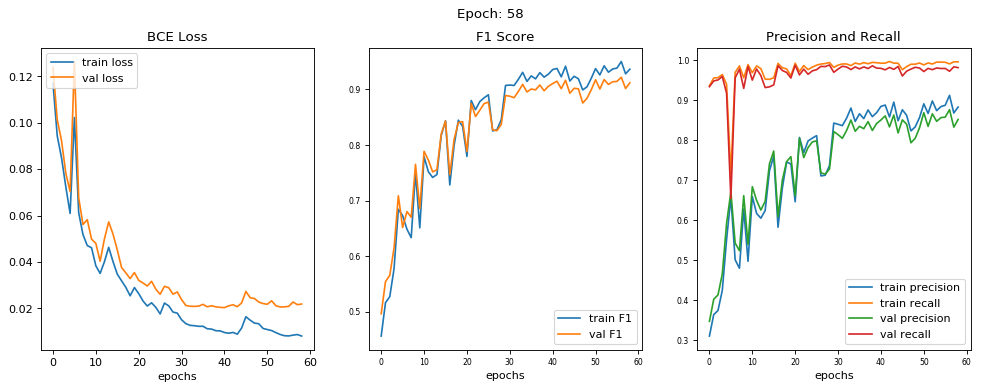

epoch [58/200] 
train loss = 0.0081, train f1 score = 0.9362 
train precision = 0.8832, train recall = 0.9962 

val loss = 0.0219, val f1 score = 0.9117 
val precision = 0.8520, val recall = 0.9817 




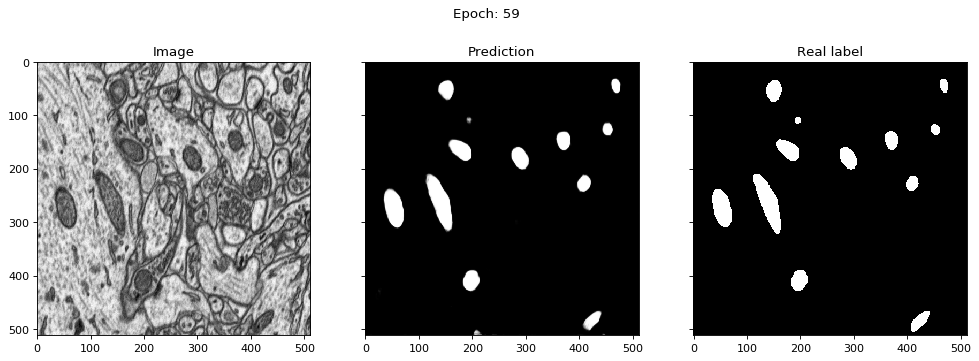

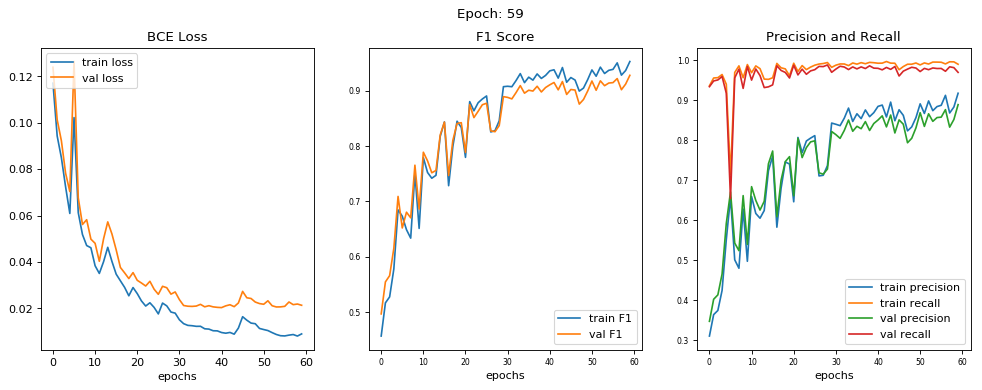

epoch [59/200] 
train loss = 0.0090, train f1 score = 0.9525 
train precision = 0.9177, train recall = 0.9902 

val loss = 0.0213, val f1 score = 0.9275 
val precision = 0.8892, val recall = 0.9699 




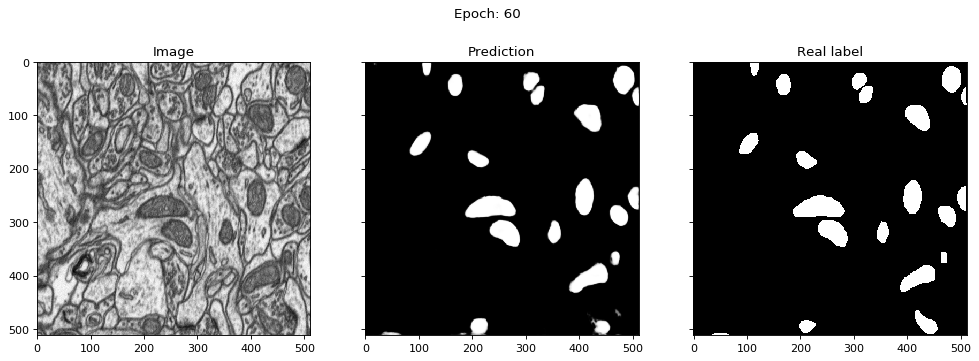

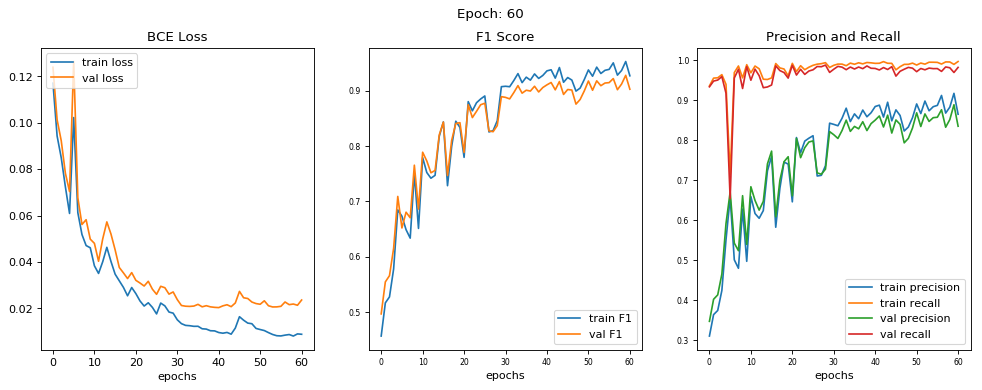

epoch [60/200] 
train loss = 0.0088, train f1 score = 0.9266 
train precision = 0.8654, train recall = 0.9974 

val loss = 0.0236, val f1 score = 0.9024 
val precision = 0.8355, val recall = 0.9826 




In [ ]:
# Prep GPU
GPU = torch.cuda.is_available()
print("GPU is {}enabled ".format(['not ', ''][GPU]))

batch_size = 1
n_epochs = 200


#unet(n_channels, n_classes, n_filters_start=64 )
un = unet(1,1)
if GPU: 
    un = un.cuda()

optimizer = torch.optim.Adam(un.parameters(), lr=0.01)
criterion = nn.BCELoss()




# split into training and validation set 
total_train_size = train_imgs.shape[0]
p = np.random.permutation(total_train_size)
train_imgs = train_imgs[p]
train_labels = train_labels[p]

val_size = int(0.9*total_train_size)

val_imgs = train_imgs[:val_size]
val_labels = train_labels[:val_size]

train_imgs = train_imgs[val_size:]
train_labels = train_labels[val_size:]

print("80/20 training/validation split")
print("total number of images = ",total_train_size)
print("training set size = ",len(train_labels))
print("val_size = ", len(val_labels))


# traning set

img_resize = 512
TrainDataset = Array_Dataset(train_imgs, train_labels, img_resize)
TrainDataLoader = DataLoader(TrainDataset,
                             batch_size=batch_size,
                             shuffle=True,
                             num_workers=4)

# validation set 
ValDataset = Array_Dataset(val_imgs, val_labels, img_resize, do_transform=False)
ValDataLoader = DataLoader(ValDataset,
                             batch_size=1,
                             shuffle=True,
                             num_workers=4)

for i, data in enumerate(TrainDataLoader):

        print("training image from batch %d" % i)
        
    

        imgs = np.array(data[0])
        labels = data[1]
       
        mask, nlabels = ndimage.label(labels[0])

        
        rand_cmap = ListedColormap(np.random.rand(256,3))

        labels_for_display = np.where(mask > 0, mask, np.nan)

        f, (ax1,ax2,ax3) = plt.subplots(1,3, sharey=True,figsize=(15,5), dpi=80)

        #original = (np.squeeze(imgs[0])+1)*127.0
        original = np.squeeze(imgs[0])
        

        ax1.imshow(original, cmap="gray")
        ax1.set_title("Original Image")
        ax1.axis('off')
        
        ax2.imshow(np.squeeze(labels[0]), cmap="gray")
        ax2.set_title("Ground Truth Mask")
        ax2.axis('off')
        
        ax3.imshow(original, cmap="gray")
        ax3.imshow(np.squeeze(labels_for_display), cmap=rand_cmap)
        ax3.set_title("Instance Segmentation (%d structures)"% nlabels)
        ax3.axis('off')
        

        plt.show()
        
        if i > 1: 
            break



output_dir = "./epfl_output/"
# run training 
#training(GPU, un,train_imgs, train_labels, val_imgs, val_labels, optimizer, criterion, n_epochs, batch_size)
training(GPU, TrainDataLoader, ValDataLoader, ValDataset, un, optimizer, criterion, n_epochs, batch_size, output_dir, warm_start=False)
